In [1]:
%matplotlib inline
import torch
from torch import nn
from torch.utils.data import DataLoader
from torchvision.datasets import CIFAR10
from torchvision import transforms
from matplotlib import pyplot as plt
from tqdm import trange
import numpy as np
dev = 'cuda' if torch.cuda.is_available() else 'cpu'
dev

'cuda'

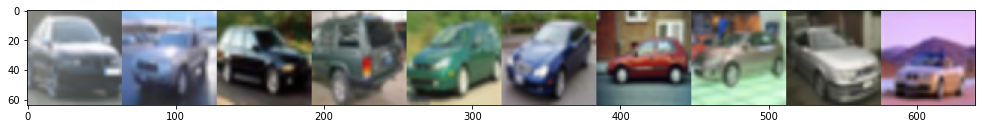

In [2]:
trans = transforms.Compose([transforms.Resize((64, 64)), transforms.ToTensor(),
                            transforms.Normalize((.5, .5, .5), (.5, .5, .5))])
dataset = CIFAR10('./dataset/', download=False, train=True, transform=trans)
cars_idx = np.array(dataset.targets) == 1
dataset.targets = list(np.array(dataset.targets)[cars_idx])
dataset.data = dataset.data[cars_idx]

BS = 128
dtld = DataLoader(dataset, batch_size=BS, shuffle=True)
a = next(iter(dtld))
def implot(imgs, losses=False, save=False):
    imgs = (imgs + 1) / 2
    imgs = imgs.movedim((0, 1, 2, 3), (0, 3, 1, 2)).detach().cpu().numpy()
    img = np.concatenate(imgs, axis=1)
    
    fig, axs = plt.subplots(1 + losses)
    fig.set_size_inches((17, 6))
    if losses:
        axs[0].plot(g_losses, label='Generator losses')
        axs[0].plot(d_losses, label='Discriminator losses')
        axs[1].imshow(img)
    else:
        axs.imshow(img)
    plt.show()
    if save:
        fig.savefig(f'./images/epoch_{epoch}')
implot(a[0][:10])

In [3]:
class PrintShape(nn.Module):
    def __init__(self):
        super(PrintShape, self).__init__()
    def forward(self, x):
        print(x.shape)
        return x

class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        
        def block(in_c, out_c, bn=True):
            b = [
                nn.Conv2d(in_c, out_c, 4, 2, 1, bias=False)
            ]
            if bn:
                b.append(nn.BatchNorm2d(out_c))
            b.append(nn.LeakyReLU(.2, inplace=True))
            return b

        self.conv = nn.Sequential(
            *block(3, 64, bn=False),
            *block(64, 128),
            *block(128, 256),
            *block(256, 512),
            nn.Conv2d(512, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

        self.flat = nn.Flatten()
    def forward(self, x):
        x = self.conv(x)
        return self.flat(x)

class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        def block(in_c, out_c, kernel=4, stride=2, padding=1):
            return [
                nn.ConvTranspose2d(in_c, out_c, kernel, stride, padding, bias=False),
                nn.BatchNorm2d(out_c),
                nn.ReLU(inplace=True)
            ]
        self.conv = nn.Sequential(
            *block(100, 512, padding=0),
            *block(512, 256),
            *block(256, 128),
            *block(128, 64),
            nn.ConvTranspose2d(64, 3, 4, 2, 1, bias=False),
            nn.Tanh(),
        )
    def forward(self, x):
        return self.conv(x.view((-1, 100, 1, 1)))

g = Generator().to(dev)
d = Discriminator().to(dev)
g_losses = []
d_losses = []
d(g(torch.randn((BS, 100), device=dev))).shape
# g(torch.randn((BS, 100), device=dev)).shape

torch.Size([128, 1])

In [4]:
def train_test_loop(dtld, train=True):
    for i, (x, _) in enumerate(dtld):
        x = x.to(dev)
        BS = x.shape[0]

        # z = (torch.randn((BS, 100), device=dev) - .5) / .5
        z = torch.randn((BS, 100), device=dev)
        ones, zeros = torch.full([BS], .9, device=dev), torch.zeros((BS), device=dev)
        gen_imgs = g(z)
        
        # Train generator
        for p in g.parameters():
            p.grad = None
        y_hat = d(gen_imgs).reshape((-1))
        g_loss = g_crit(y_hat, ones)
        g_loss.backward()
        g_optim.step()

        # Train discriminator
        for p in d.parameters():
            p.grad = None
        ones_hat, zeros_hat = d(x).reshape((-1)), d(gen_imgs.detach()).reshape((-1))
        d_loss = (d_crit(ones_hat, ones) + d_crit(zeros_hat, zeros)) / 2
        d_loss.backward()
        d_optim.step()

        g_losses.append(g_loss.item())
        d_losses.append(d_loss.item())

  0%|          | 0/100 [00:00<?, ?it/s]

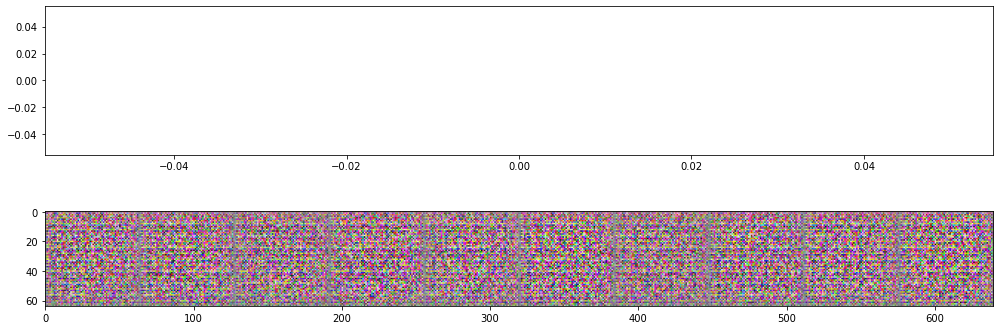

D_losses=0.2624 | G_losses=12.2103:   1%|          | 1/100 [00:13<21:35, 13.08s/it]

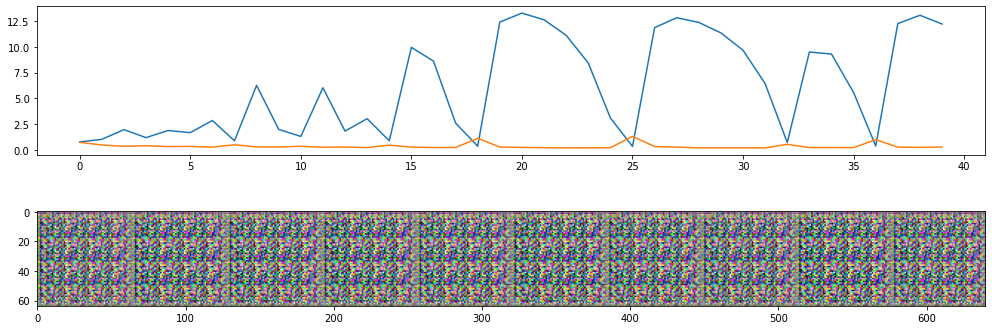

D_losses=0.3246 | G_losses=8.1004:   2%|▏         | 2/100 [00:26<21:27, 13.13s/it] 

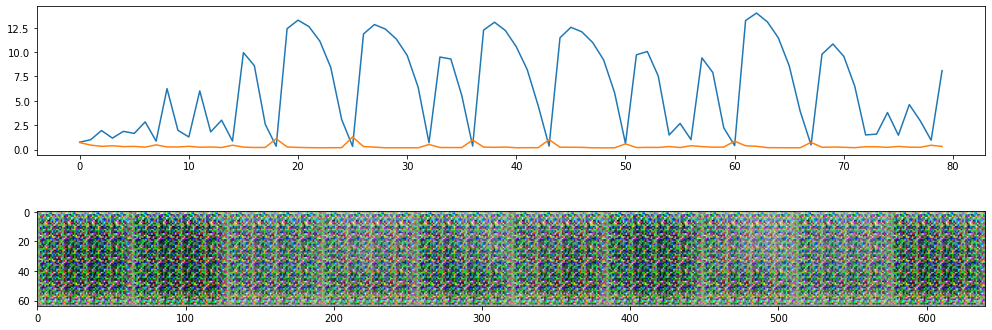

D_losses=0.3569 | G_losses=1.4196:   3%|▎         | 3/100 [00:39<21:19, 13.19s/it]

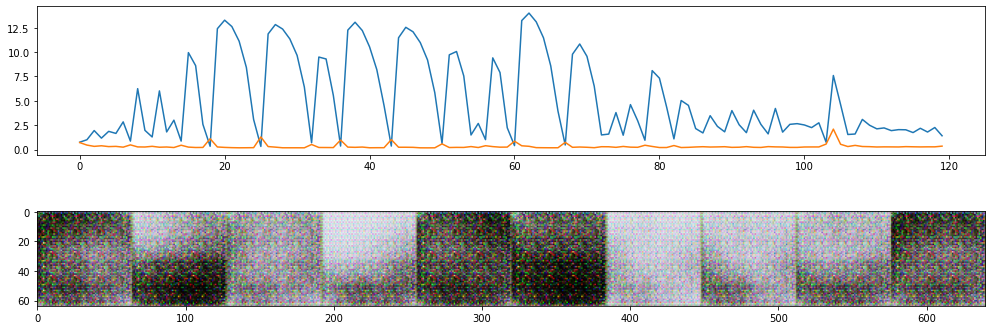

D_losses=0.2926 | G_losses=1.9887:   4%|▍         | 4/100 [00:52<21:14, 13.28s/it]

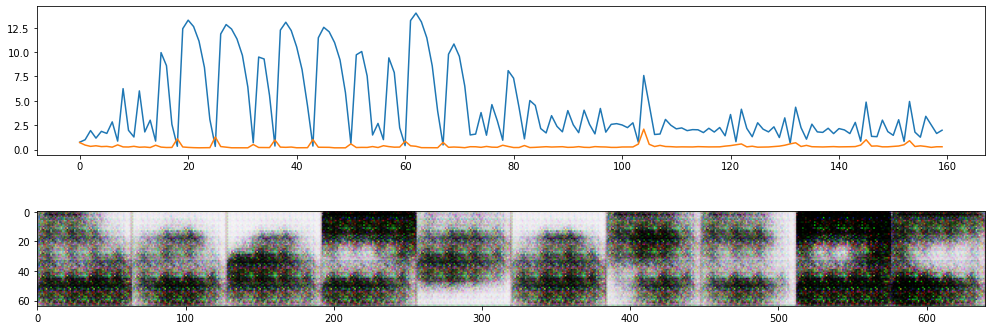

D_losses=0.1978 | G_losses=3.1396:   5%|▌         | 5/100 [01:06<21:03, 13.30s/it]

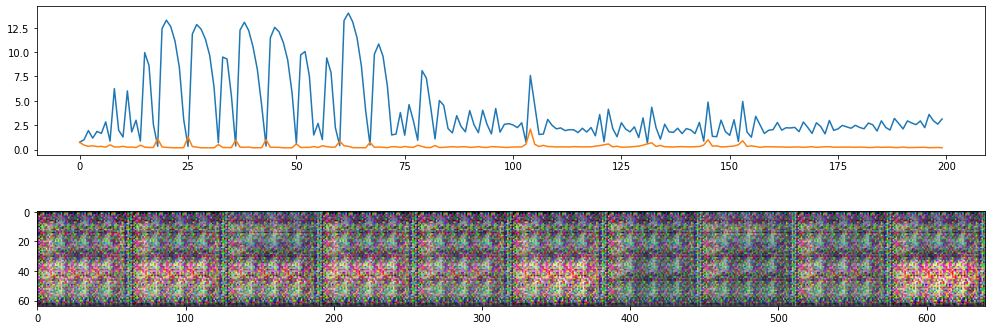

D_losses=0.2682 | G_losses=2.6822:   6%|▌         | 6/100 [01:19<20:54, 13.35s/it]

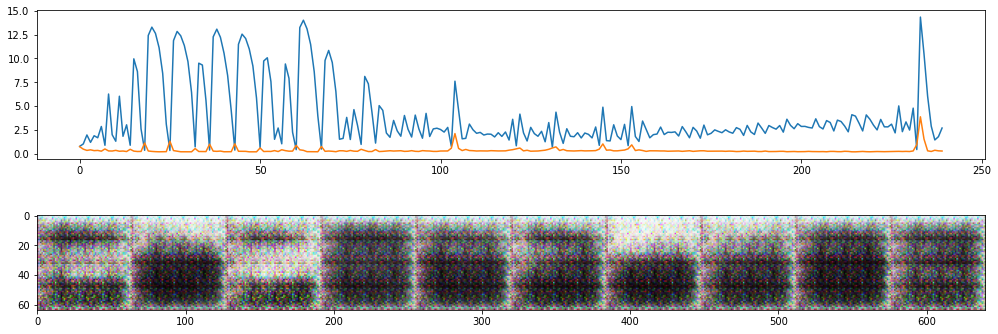

D_losses=0.2132 | G_losses=3.4370:   7%|▋         | 7/100 [01:32<20:38, 13.32s/it]

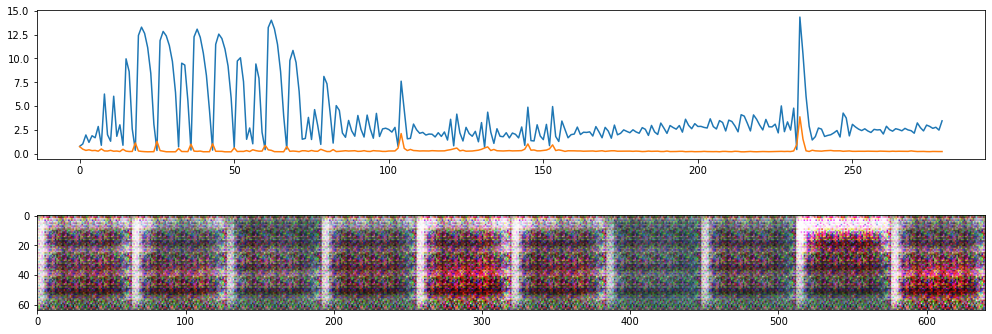

D_losses=0.2721 | G_losses=2.9370:   8%|▊         | 8/100 [01:46<20:29, 13.36s/it]

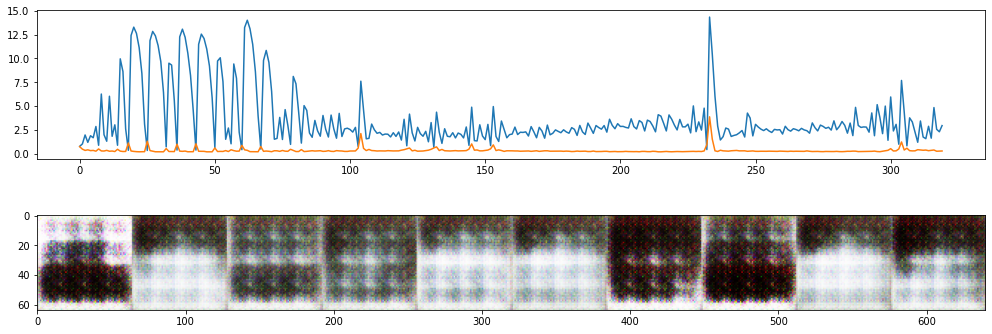

D_losses=0.2679 | G_losses=2.1080:   9%|▉         | 9/100 [01:59<20:11, 13.31s/it]

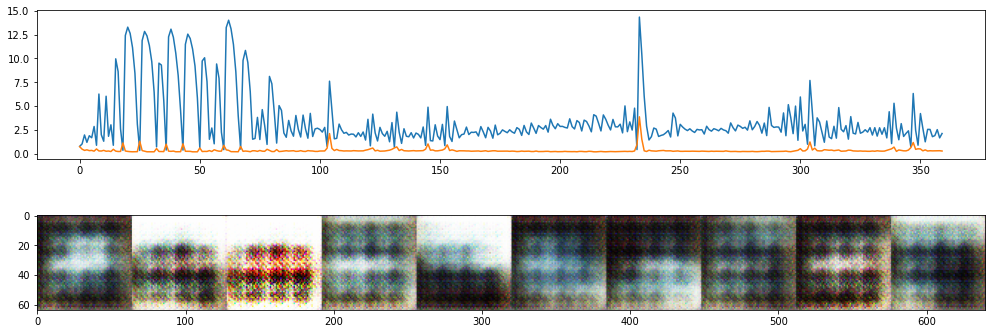

D_losses=0.2290 | G_losses=3.5273:  10%|█         | 10/100 [02:12<19:55, 13.28s/it]

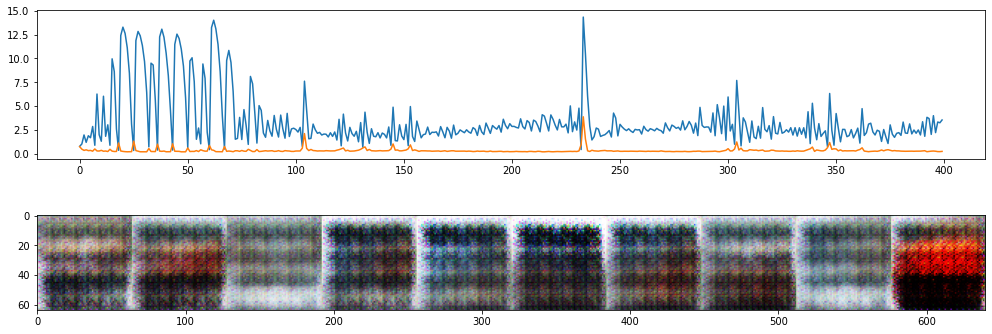

D_losses=0.2676 | G_losses=1.7563:  11%|█         | 11/100 [02:26<19:39, 13.26s/it]

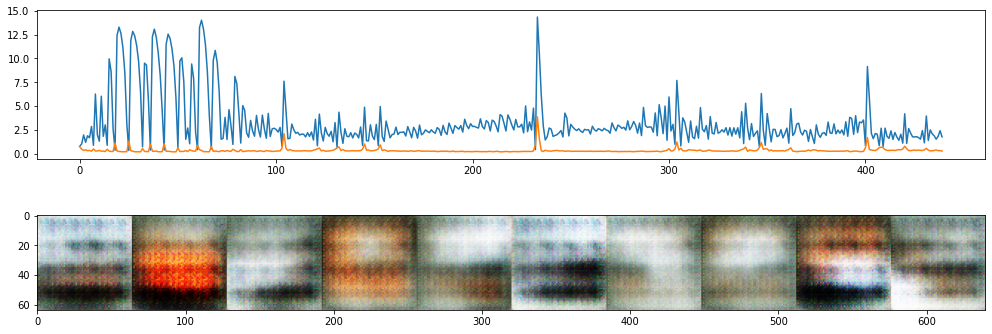

D_losses=0.2174 | G_losses=2.5938:  12%|█▏        | 12/100 [02:39<19:26, 13.25s/it]

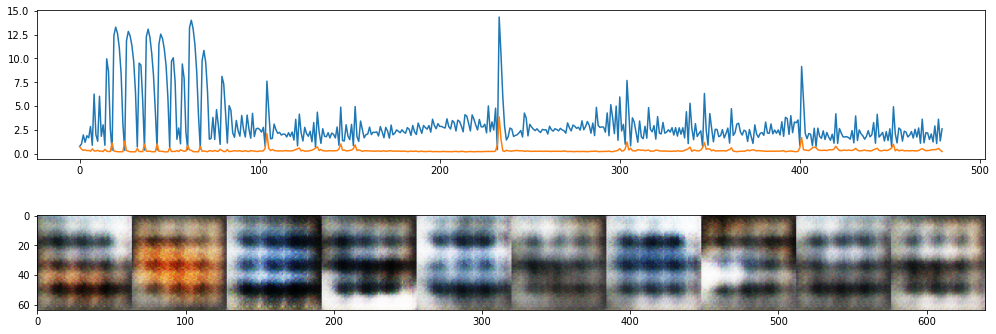

D_losses=0.6436 | G_losses=5.1412:  13%|█▎        | 13/100 [02:52<19:14, 13.27s/it]

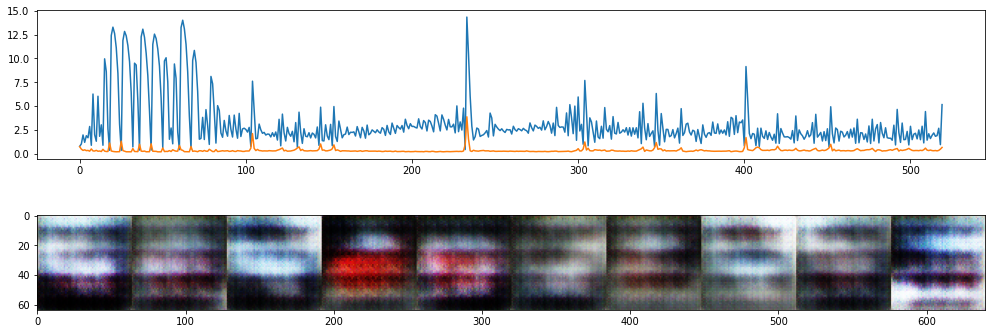

D_losses=0.3561 | G_losses=2.3728:  14%|█▍        | 14/100 [03:05<19:00, 13.26s/it]

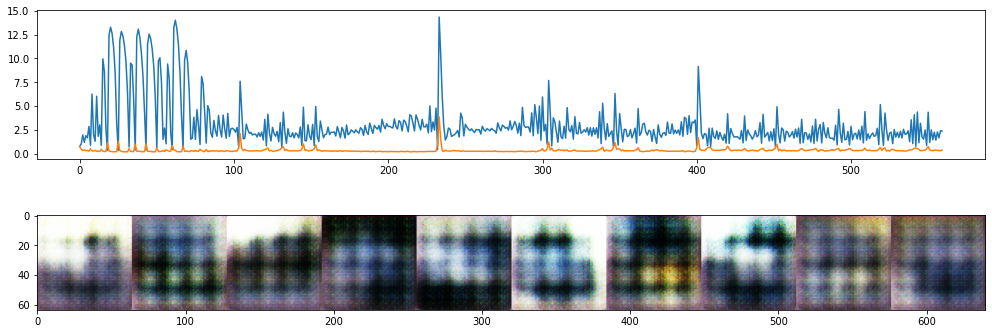

D_losses=0.2994 | G_losses=2.4683:  15%|█▌        | 15/100 [03:19<18:49, 13.28s/it]

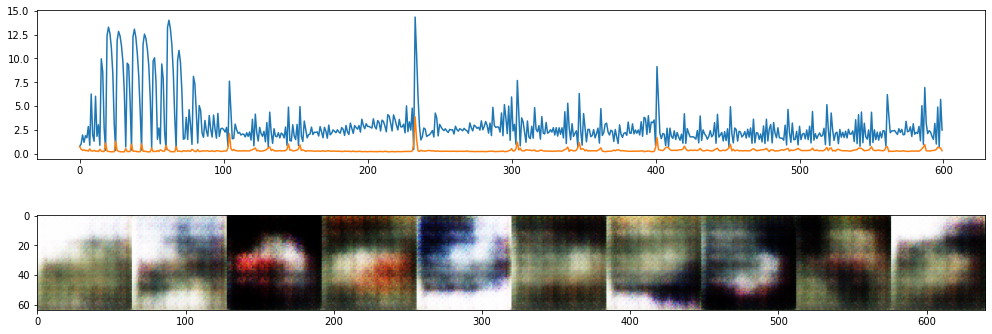

D_losses=0.2359 | G_losses=2.6836:  16%|█▌        | 16/100 [03:32<18:37, 13.30s/it]

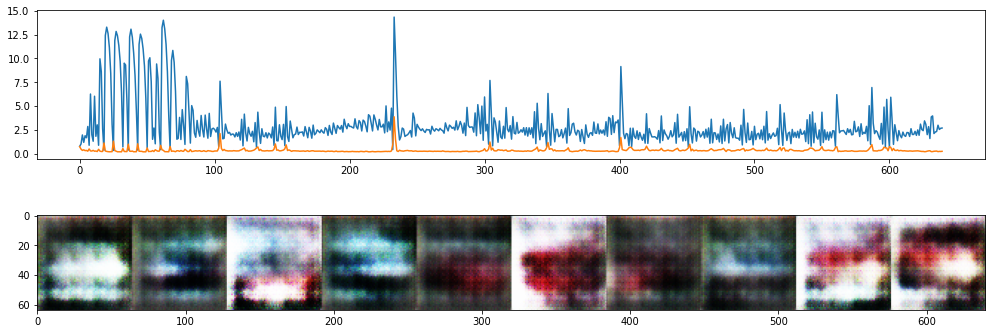

D_losses=0.2758 | G_losses=1.9372:  17%|█▋        | 17/100 [03:45<18:23, 13.30s/it]

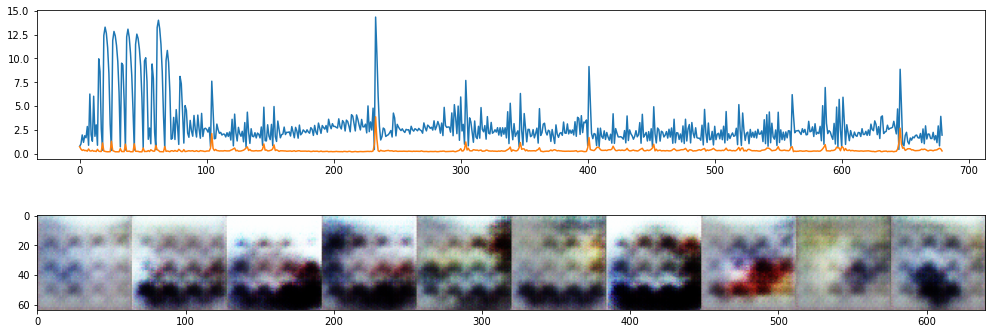

D_losses=0.1885 | G_losses=3.9511:  18%|█▊        | 18/100 [03:59<18:10, 13.30s/it]

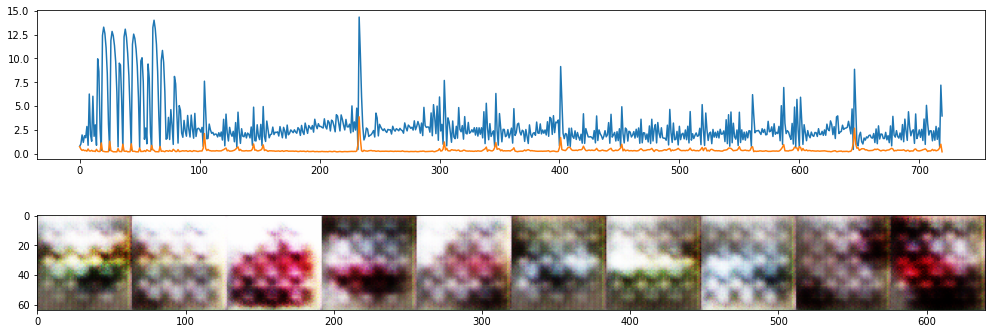

D_losses=0.3041 | G_losses=2.1095:  19%|█▉        | 19/100 [04:12<17:57, 13.30s/it]

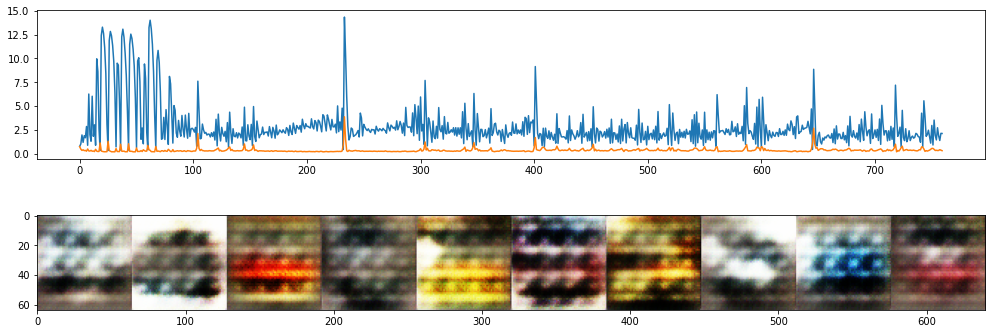

D_losses=0.8504 | G_losses=2.8141:  20%|██        | 20/100 [04:25<17:44, 13.31s/it]

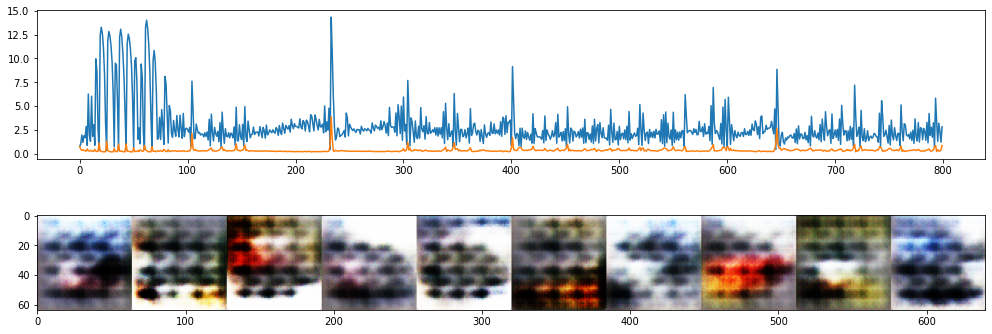

D_losses=0.3167 | G_losses=3.7935:  21%|██        | 21/100 [04:39<17:30, 13.30s/it]

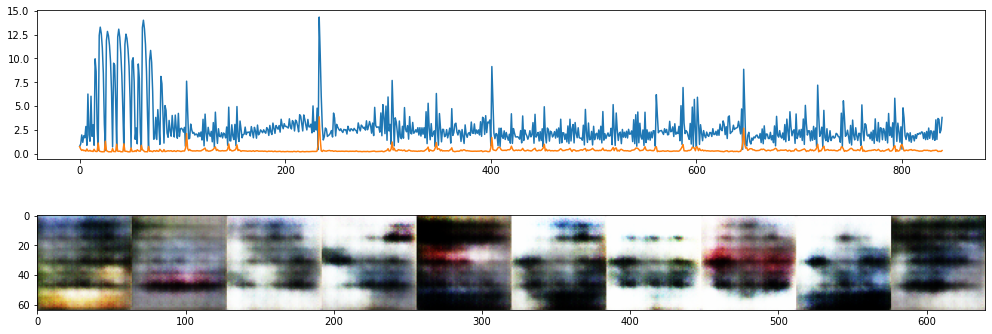

D_losses=0.4595 | G_losses=2.8780:  22%|██▏       | 22/100 [04:52<17:15, 13.28s/it]

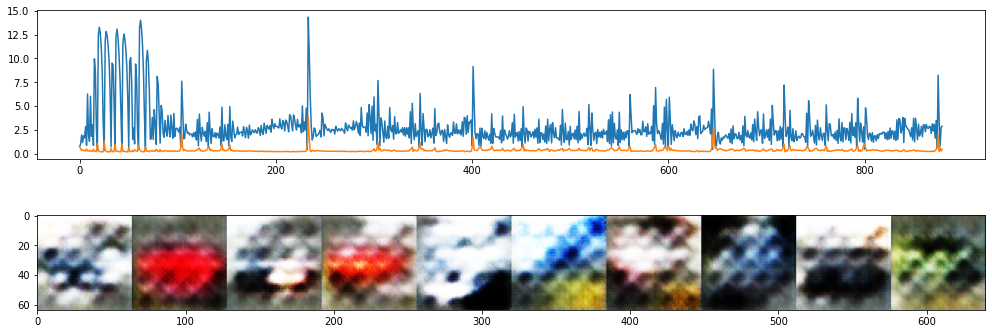

D_losses=0.2783 | G_losses=2.6088:  23%|██▎       | 23/100 [05:05<17:02, 13.28s/it]

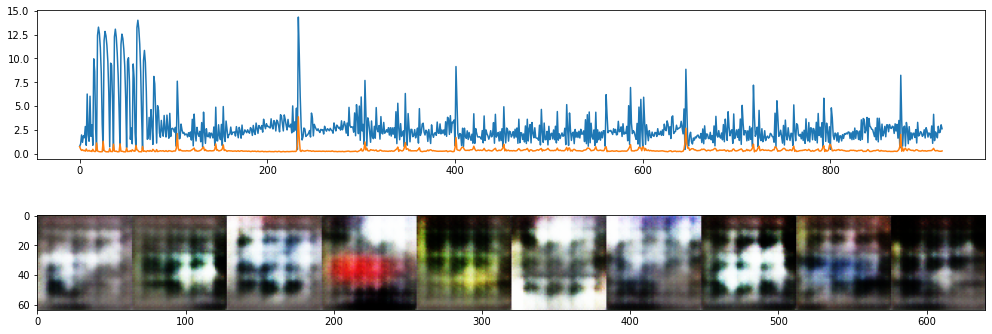

D_losses=0.4312 | G_losses=1.1188:  24%|██▍       | 24/100 [05:18<16:47, 13.26s/it]

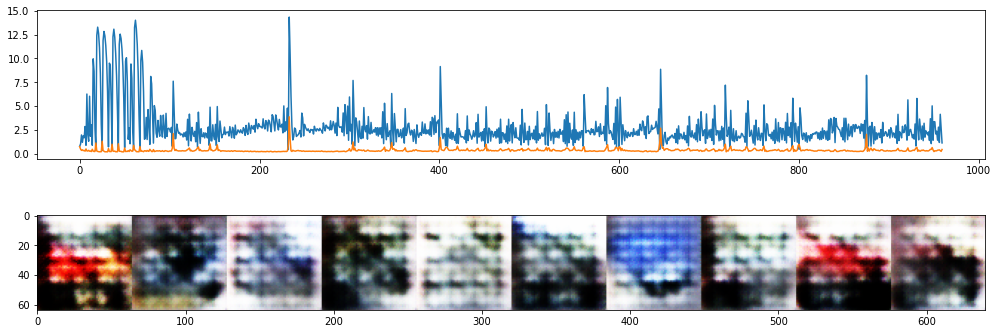

D_losses=0.4081 | G_losses=1.6341:  25%|██▌       | 25/100 [05:32<16:42, 13.36s/it]

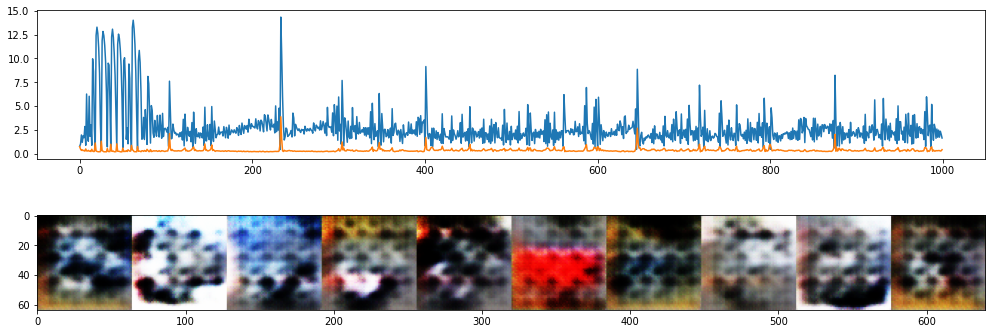

D_losses=0.3929 | G_losses=2.8451:  26%|██▌       | 26/100 [05:45<16:28, 13.36s/it]

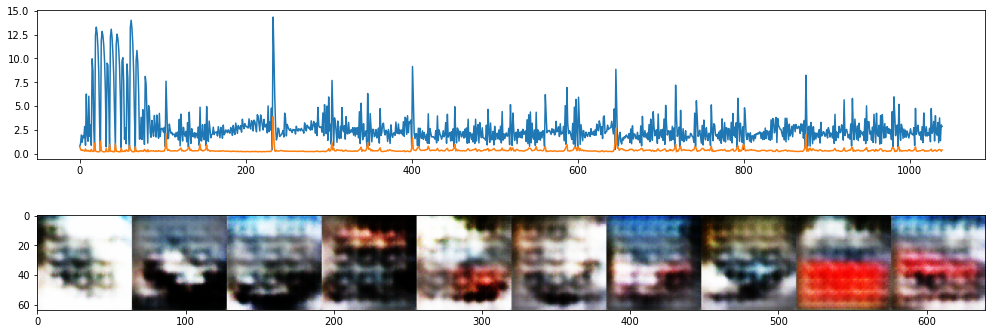

D_losses=1.0280 | G_losses=6.0303:  27%|██▋       | 27/100 [05:59<16:17, 13.39s/it]

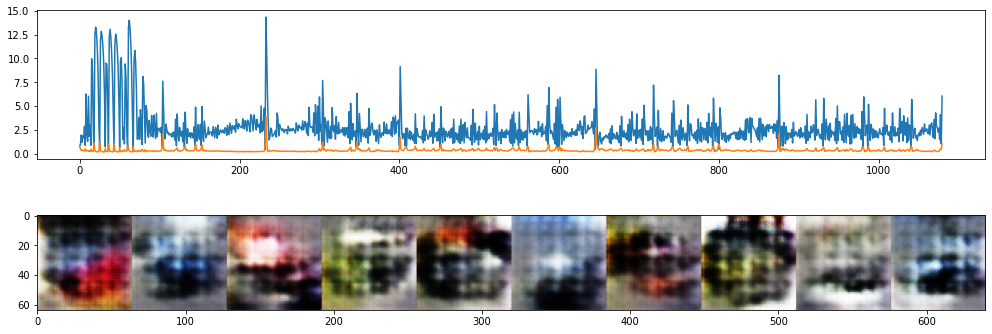

D_losses=0.3841 | G_losses=3.0678:  28%|██▊       | 28/100 [06:12<16:08, 13.45s/it]

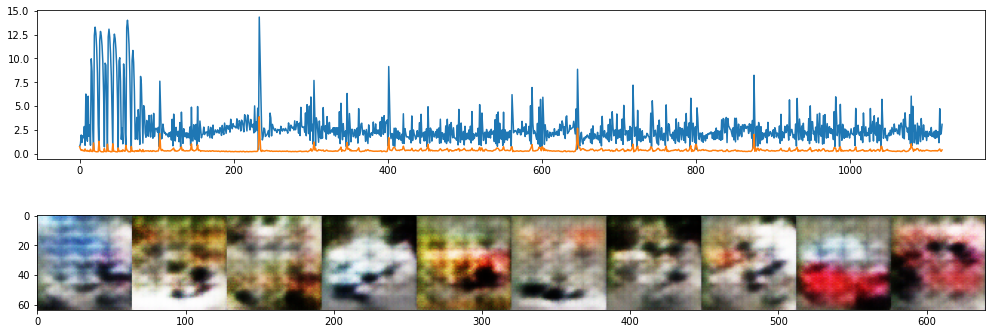

D_losses=0.4016 | G_losses=1.1640:  29%|██▉       | 29/100 [06:26<15:56, 13.47s/it]

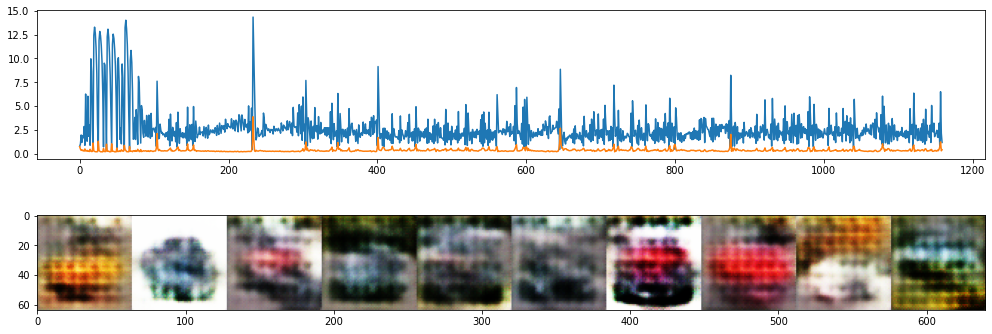

D_losses=0.1840 | G_losses=3.4557:  30%|███       | 30/100 [06:39<15:37, 13.40s/it]

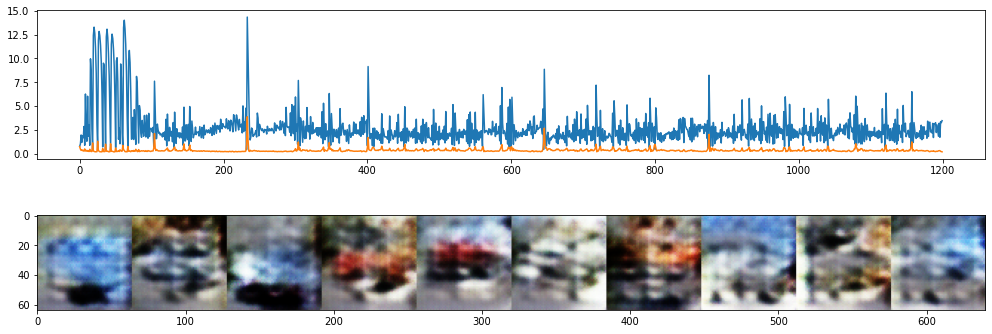

D_losses=0.3505 | G_losses=2.2307:  31%|███       | 31/100 [06:52<15:23, 13.39s/it]

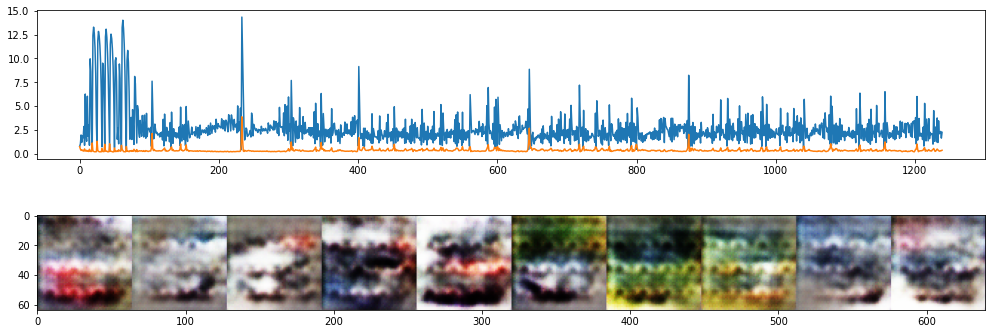

D_losses=0.4175 | G_losses=2.7308:  32%|███▏      | 32/100 [07:06<15:07, 13.35s/it]

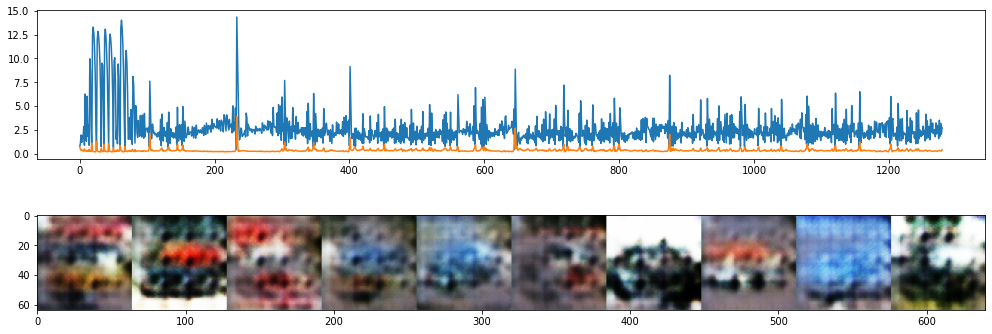

D_losses=0.3837 | G_losses=3.7233:  33%|███▎      | 33/100 [07:19<14:55, 13.36s/it]

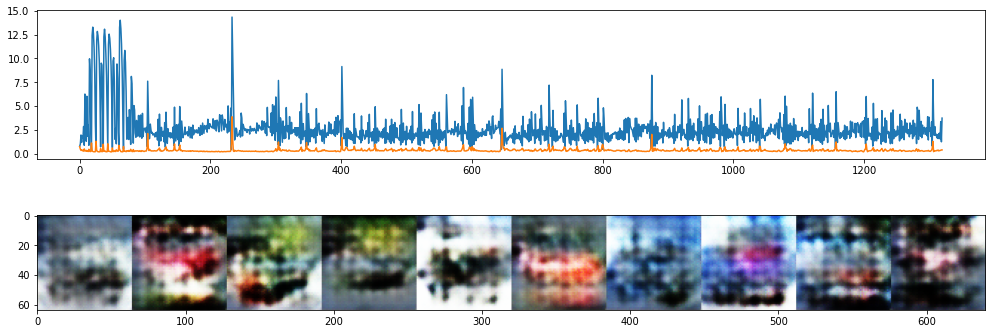

D_losses=0.2113 | G_losses=4.2533:  34%|███▍      | 34/100 [07:32<14:42, 13.37s/it]

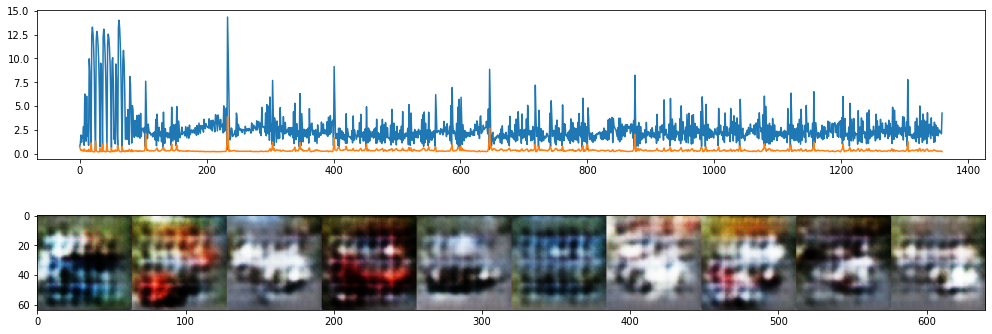

D_losses=0.4915 | G_losses=2.7802:  35%|███▌      | 35/100 [07:46<14:29, 13.37s/it]

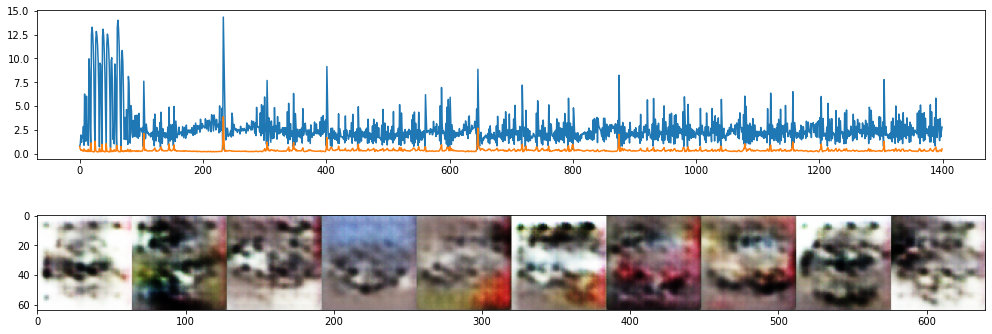

D_losses=0.2540 | G_losses=2.1987:  36%|███▌      | 36/100 [07:59<14:14, 13.35s/it]

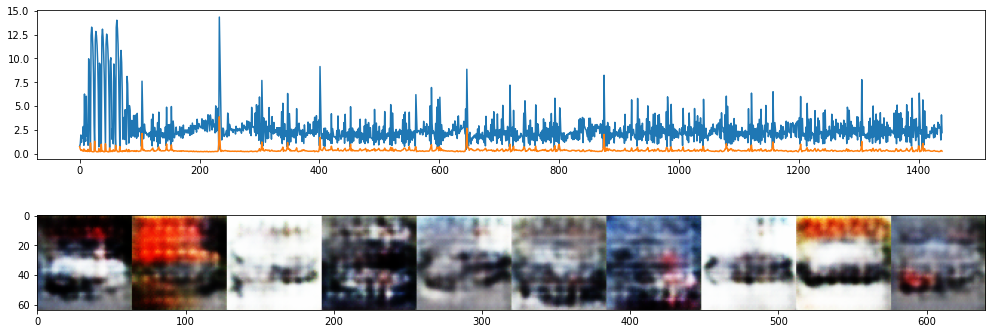

D_losses=0.2604 | G_losses=4.4032:  37%|███▋      | 37/100 [08:13<14:04, 13.41s/it]

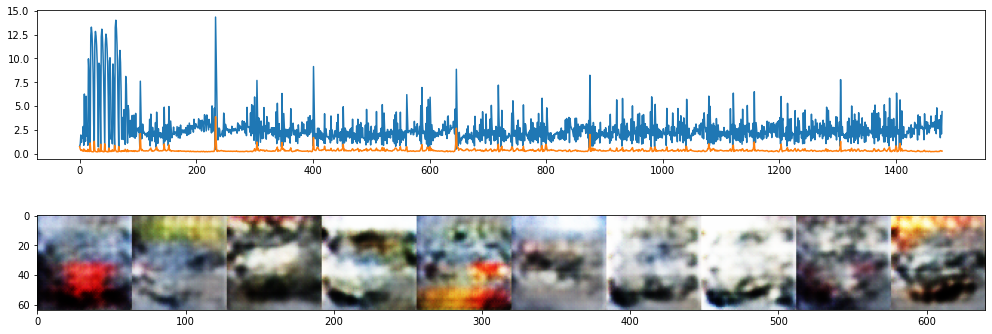

D_losses=0.4283 | G_losses=1.1272:  38%|███▊      | 38/100 [08:26<13:49, 13.38s/it]

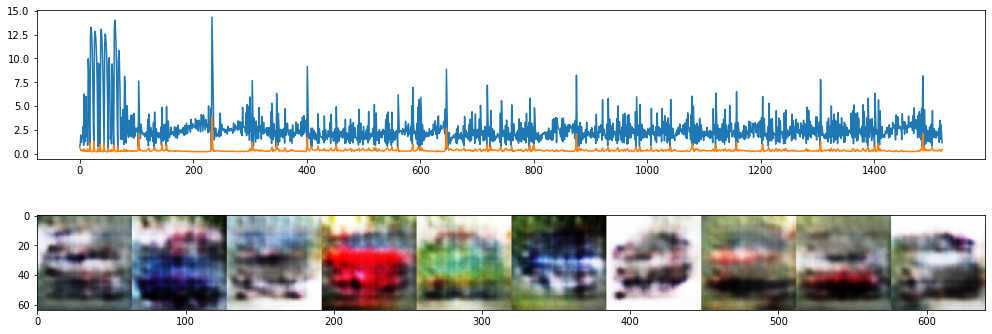

D_losses=0.2757 | G_losses=4.1901:  39%|███▉      | 39/100 [08:39<13:39, 13.43s/it]

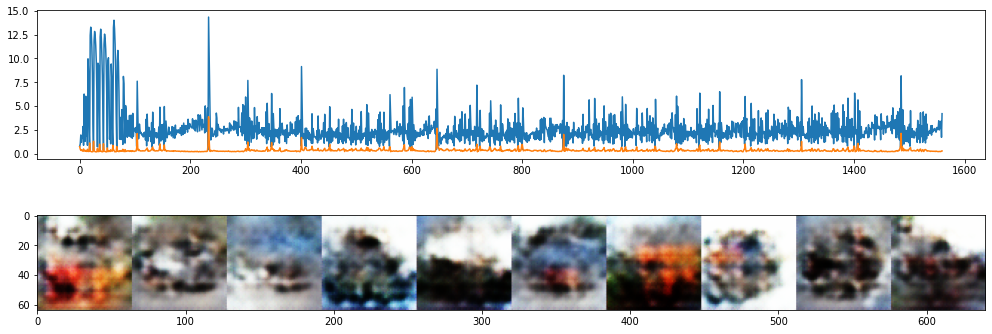

D_losses=0.3552 | G_losses=1.7074:  40%|████      | 40/100 [08:53<13:25, 13.42s/it]

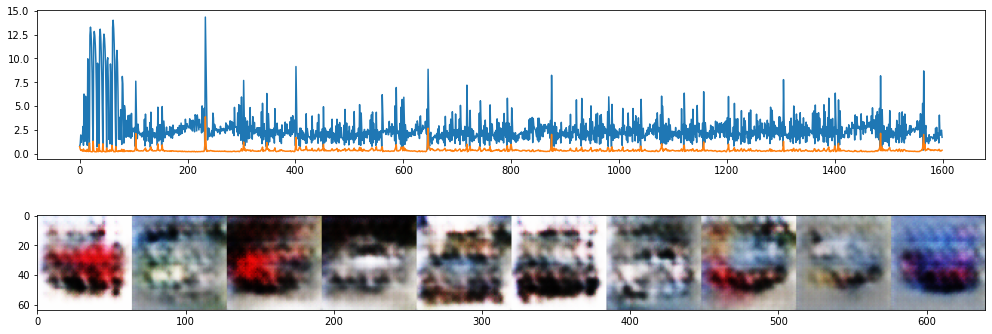

D_losses=0.5320 | G_losses=3.8053:  41%|████      | 41/100 [09:06<13:10, 13.40s/it]

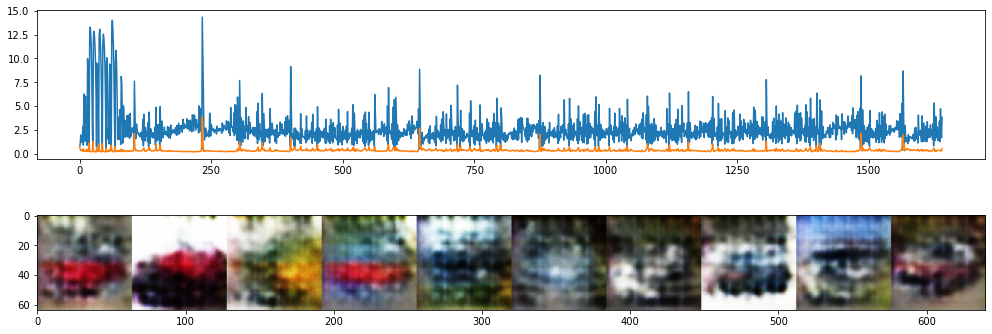

D_losses=0.3179 | G_losses=2.5410:  42%|████▏     | 42/100 [09:20<12:57, 13.40s/it]

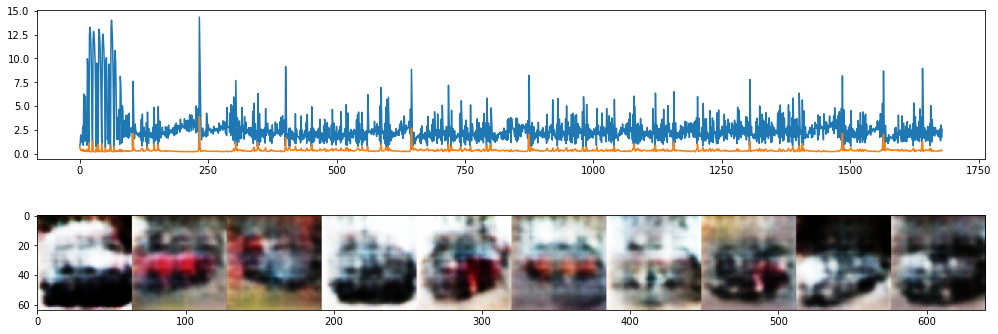

D_losses=0.3780 | G_losses=7.2045:  43%|████▎     | 43/100 [09:33<12:46, 13.45s/it]

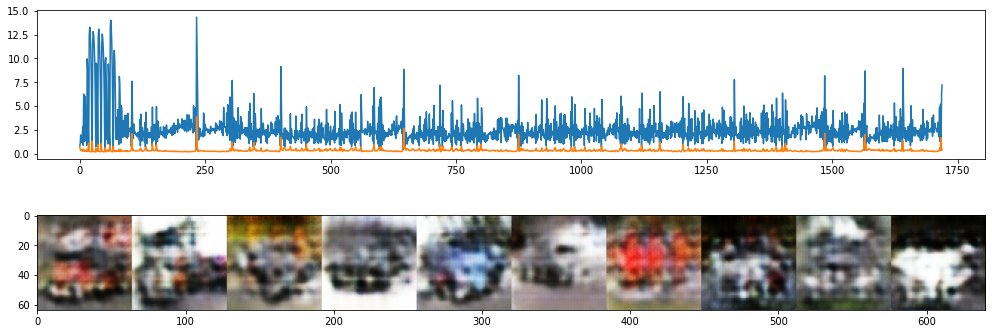

D_losses=0.2393 | G_losses=2.7696:  44%|████▍     | 44/100 [09:47<12:30, 13.40s/it]

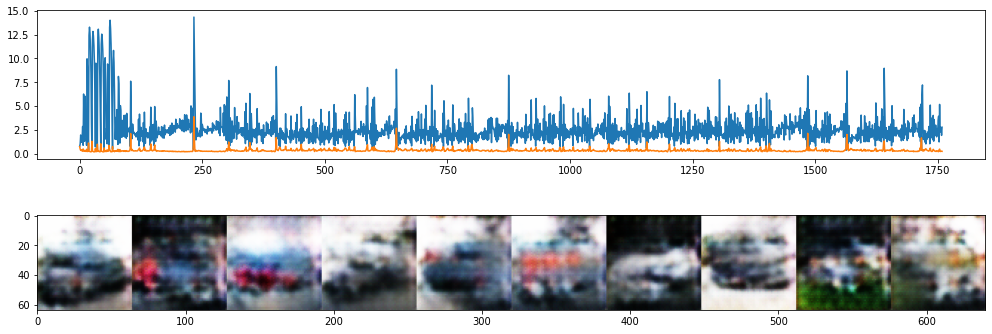

D_losses=0.9965 | G_losses=6.8354:  45%|████▌     | 45/100 [10:00<12:14, 13.36s/it]

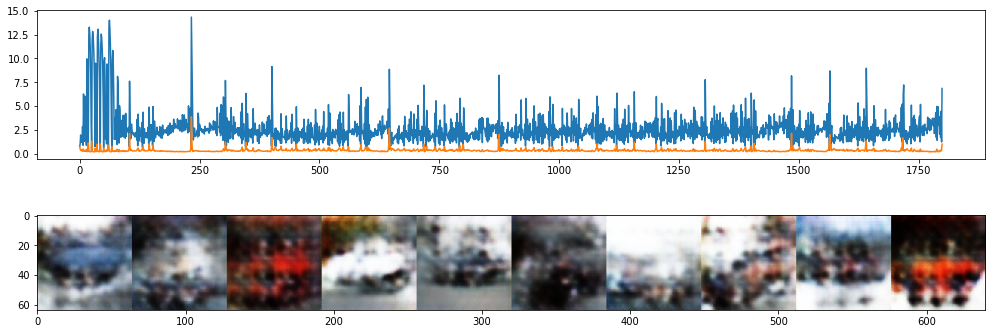

D_losses=0.2613 | G_losses=2.7246:  46%|████▌     | 46/100 [10:13<12:00, 13.34s/it]

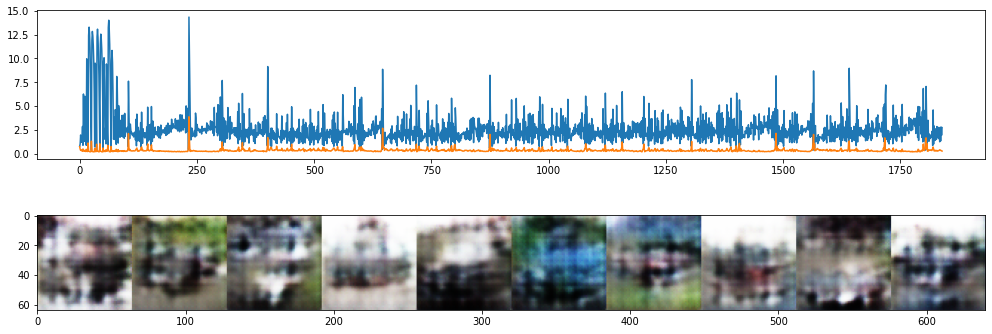

D_losses=0.6390 | G_losses=4.2636:  47%|████▋     | 47/100 [10:26<11:45, 13.31s/it]

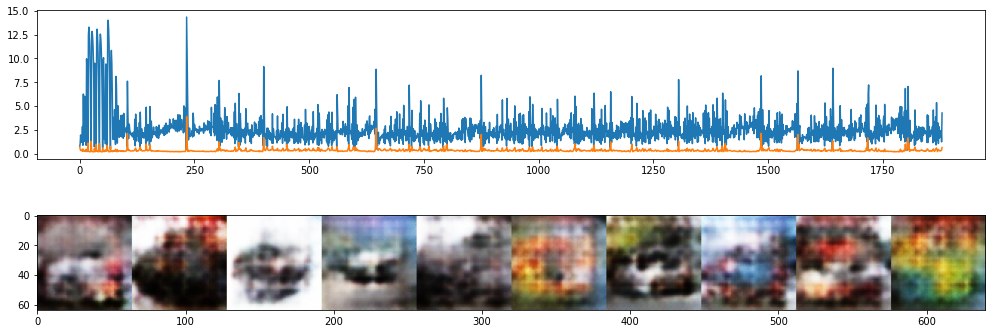

D_losses=0.5068 | G_losses=0.7724:  48%|████▊     | 48/100 [10:40<11:32, 13.32s/it]

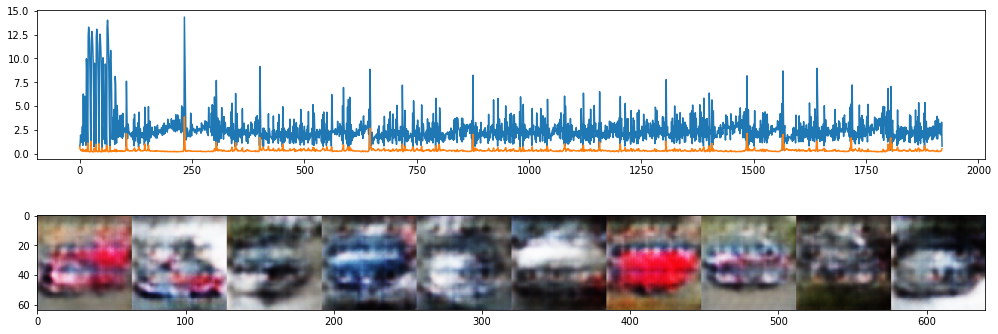

D_losses=0.1918 | G_losses=3.6061:  49%|████▉     | 49/100 [10:53<11:19, 13.32s/it]

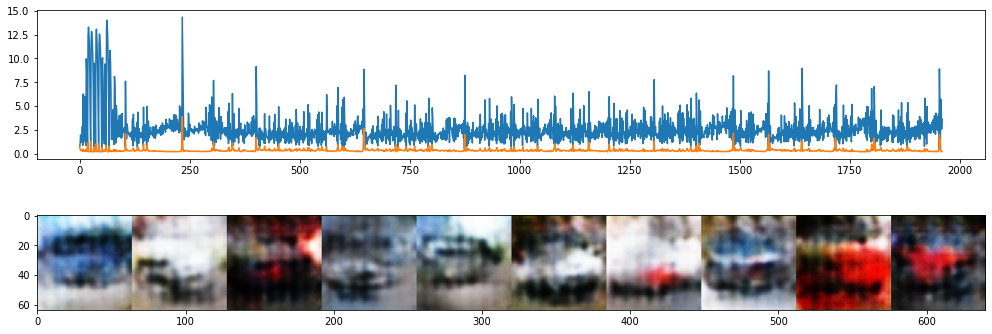

D_losses=0.3254 | G_losses=1.8034:  50%|█████     | 50/100 [11:06<11:05, 13.32s/it]

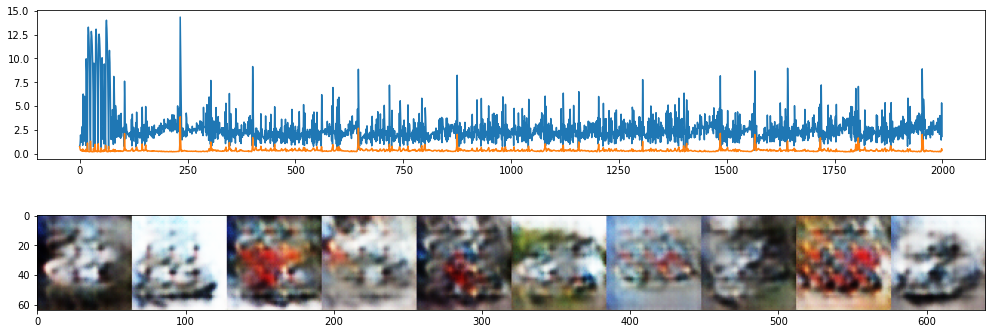

D_losses=0.1760 | G_losses=3.5243:  51%|█████     | 51/100 [11:20<10:52, 13.31s/it]

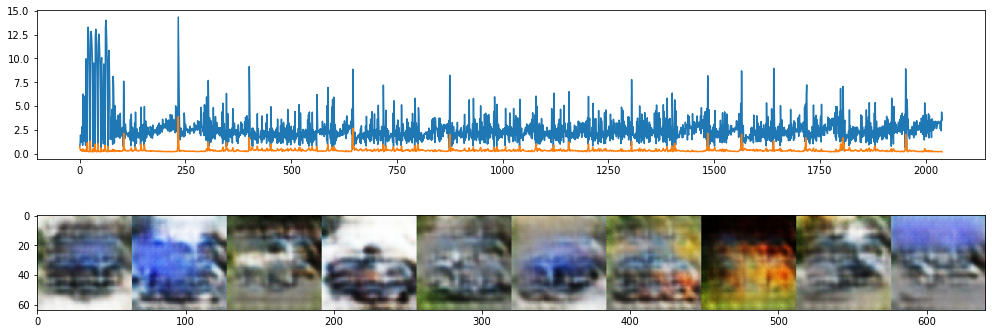

D_losses=0.2412 | G_losses=2.9203:  52%|█████▏    | 52/100 [11:33<10:43, 13.40s/it]

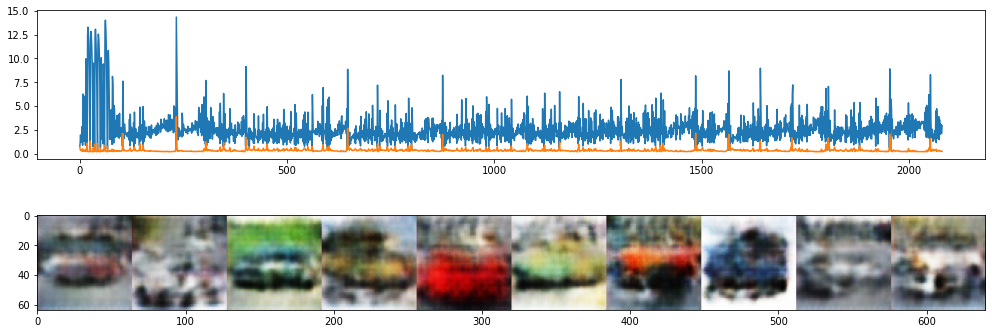

D_losses=0.2231 | G_losses=2.5609:  53%|█████▎    | 53/100 [11:47<10:30, 13.42s/it]

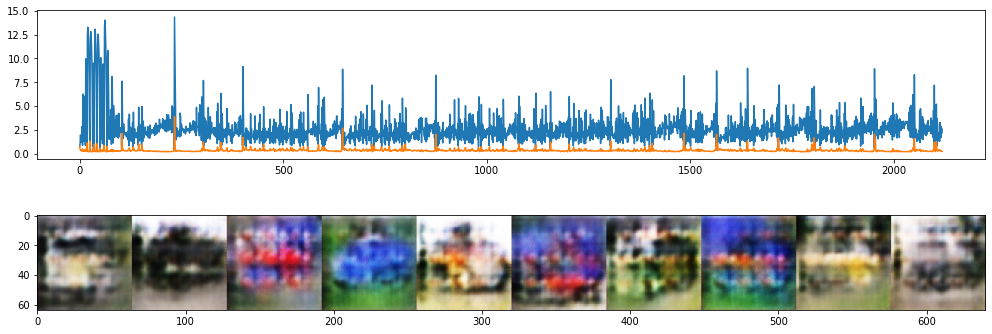

D_losses=0.3521 | G_losses=3.2070:  54%|█████▍    | 54/100 [12:00<10:16, 13.41s/it]

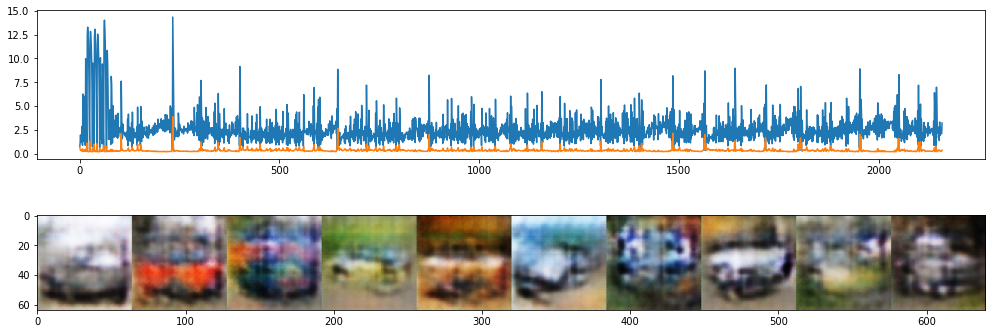

D_losses=0.2092 | G_losses=2.5058:  55%|█████▌    | 55/100 [12:13<10:03, 13.41s/it]

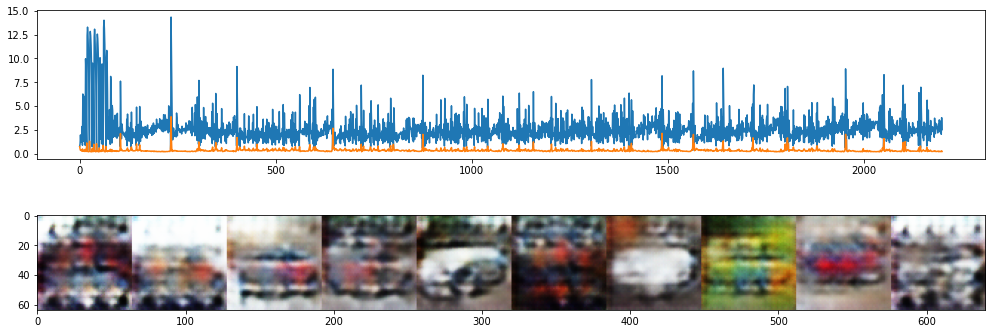

D_losses=0.1970 | G_losses=2.8130:  56%|█████▌    | 56/100 [12:27<09:51, 13.44s/it]

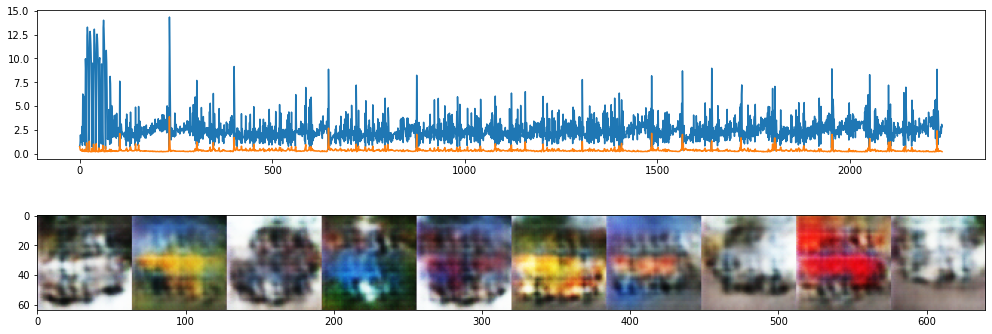

D_losses=0.2017 | G_losses=2.8698:  57%|█████▋    | 57/100 [12:41<09:41, 13.52s/it]

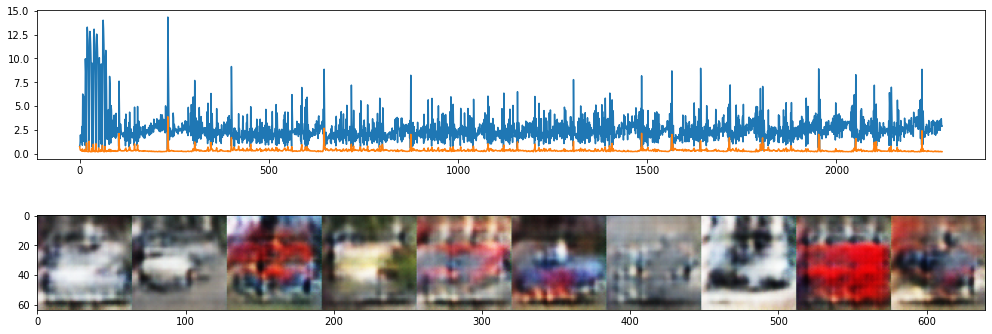

D_losses=2.1371 | G_losses=8.1368:  58%|█████▊    | 58/100 [12:54<09:25, 13.46s/it]

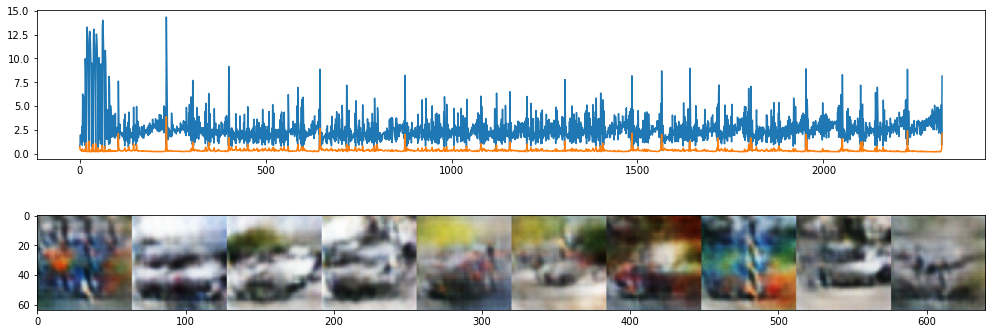

D_losses=0.3333 | G_losses=1.6928:  59%|█████▉    | 59/100 [13:07<09:10, 13.44s/it]

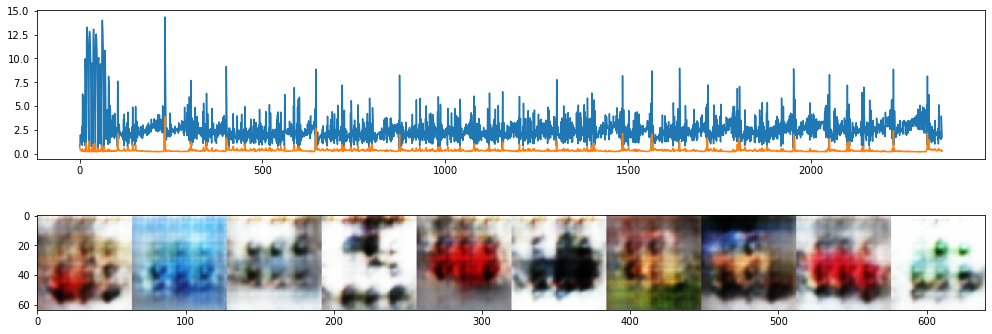

D_losses=0.3794 | G_losses=1.4640:  60%|██████    | 60/100 [13:21<08:55, 13.38s/it]

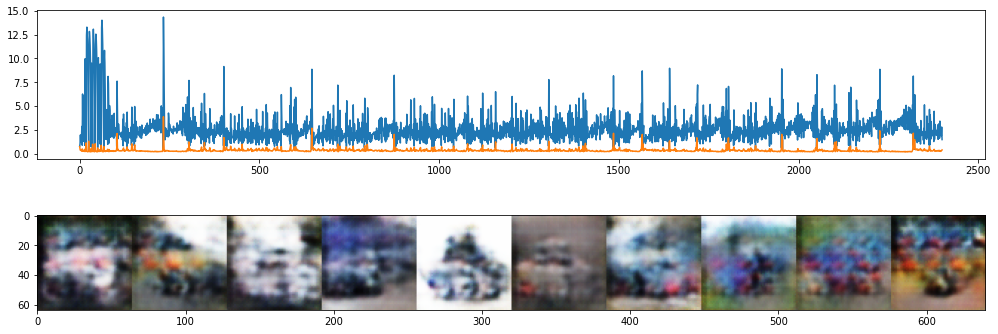

D_losses=0.2189 | G_losses=2.6608:  61%|██████    | 61/100 [13:34<08:40, 13.35s/it]

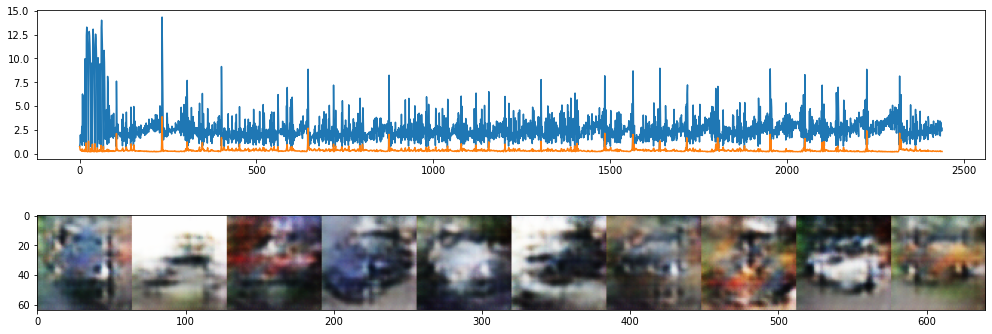

D_losses=0.2217 | G_losses=3.2781:  62%|██████▏   | 62/100 [13:47<08:28, 13.37s/it]

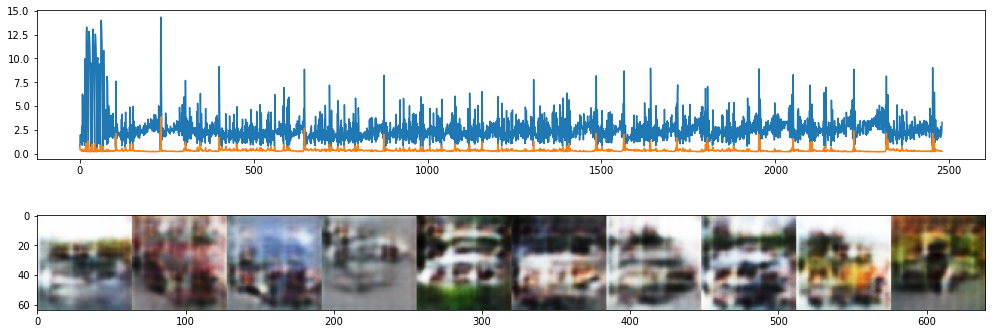

D_losses=0.2241 | G_losses=3.6731:  63%|██████▎   | 63/100 [14:01<08:15, 13.39s/it]

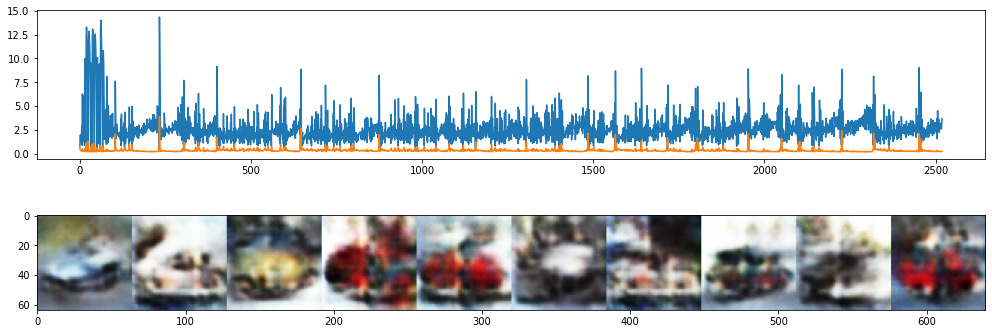

D_losses=2.0153 | G_losses=7.4359:  64%|██████▍   | 64/100 [14:14<08:01, 13.36s/it]

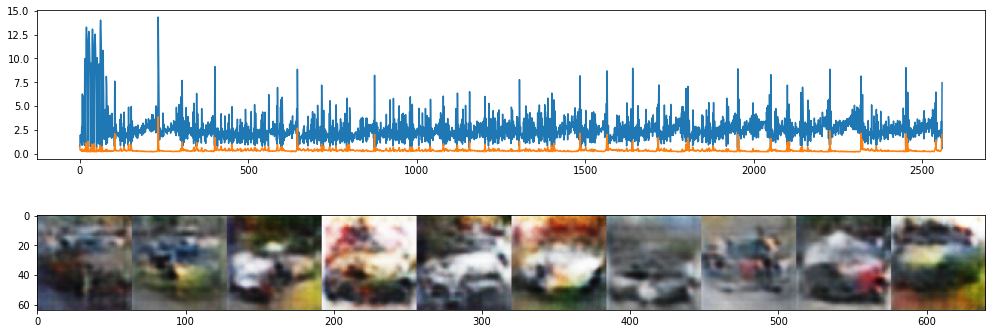

D_losses=0.2253 | G_losses=2.9739:  65%|██████▌   | 65/100 [14:27<07:46, 13.33s/it]

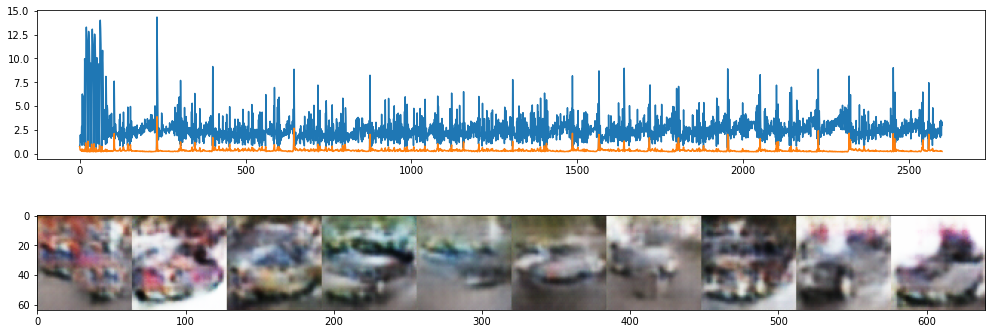

D_losses=0.2259 | G_losses=3.6586:  66%|██████▌   | 66/100 [14:41<07:33, 13.34s/it]

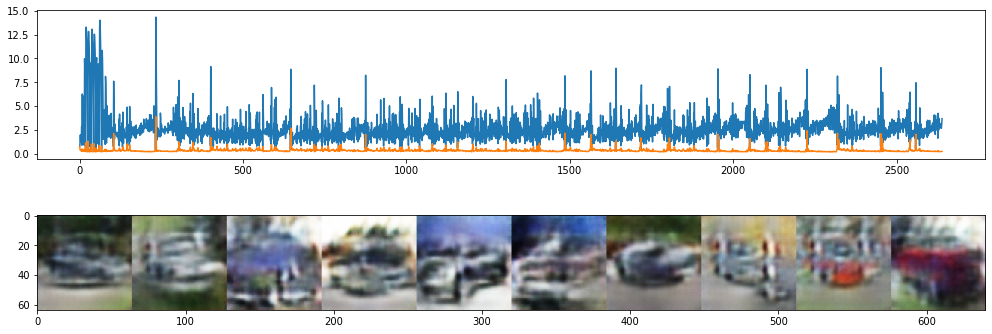

D_losses=0.2562 | G_losses=3.8448:  67%|██████▋   | 67/100 [14:54<07:20, 13.35s/it]

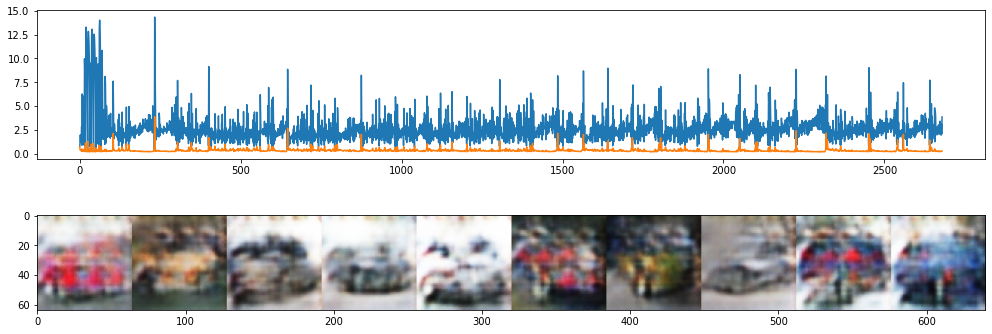

D_losses=0.1758 | G_losses=4.3645:  68%|██████▊   | 68/100 [15:07<07:07, 13.37s/it]

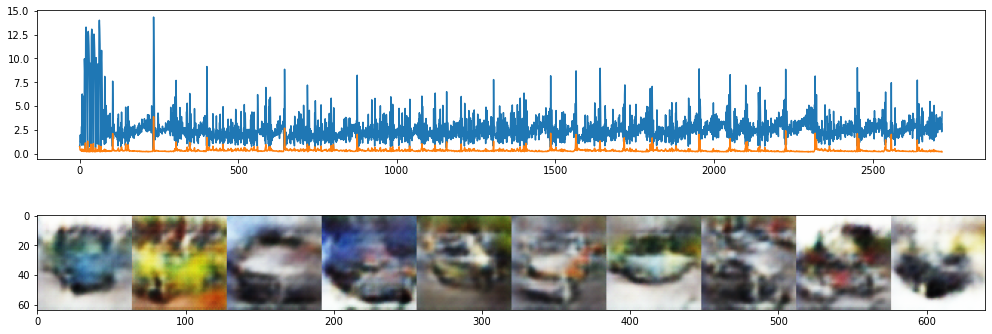

D_losses=0.3222 | G_losses=2.0142:  69%|██████▉   | 69/100 [15:21<06:53, 13.34s/it]

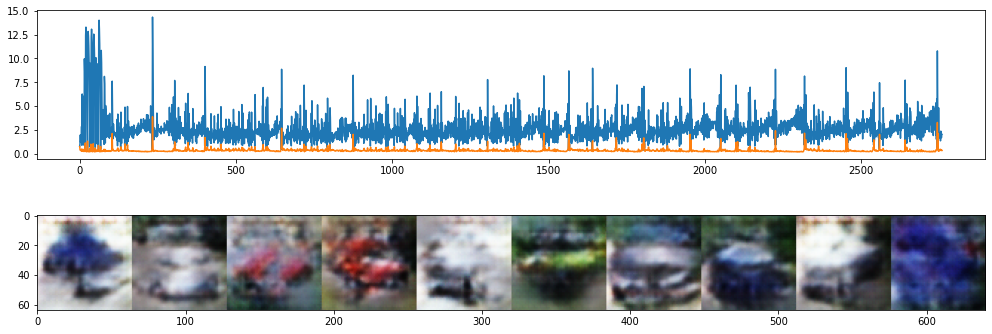

D_losses=0.4046 | G_losses=3.0142:  70%|███████   | 70/100 [15:34<06:40, 13.37s/it]

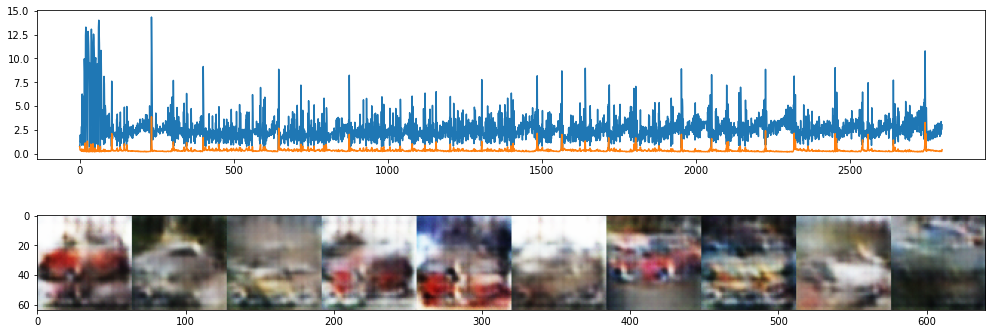

D_losses=0.2231 | G_losses=2.6963:  71%|███████   | 71/100 [15:48<06:28, 13.39s/it]

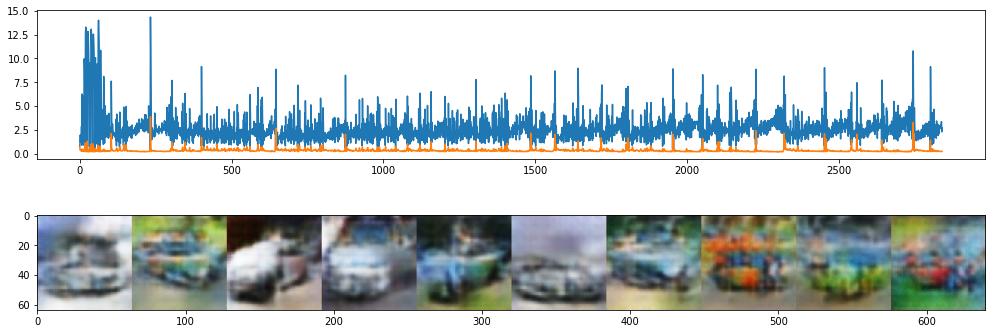

D_losses=0.2546 | G_losses=3.3964:  72%|███████▏  | 72/100 [16:01<06:14, 13.39s/it]

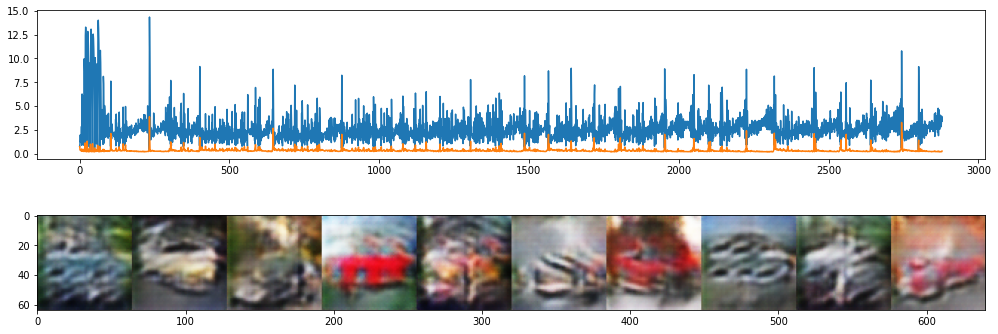

D_losses=0.2926 | G_losses=2.6377:  73%|███████▎  | 73/100 [16:14<06:01, 13.39s/it]

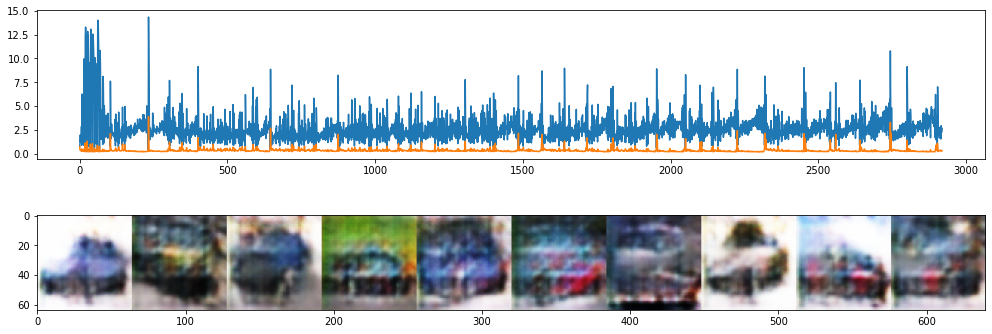

D_losses=0.2472 | G_losses=1.9704:  74%|███████▍  | 74/100 [16:28<05:50, 13.48s/it]

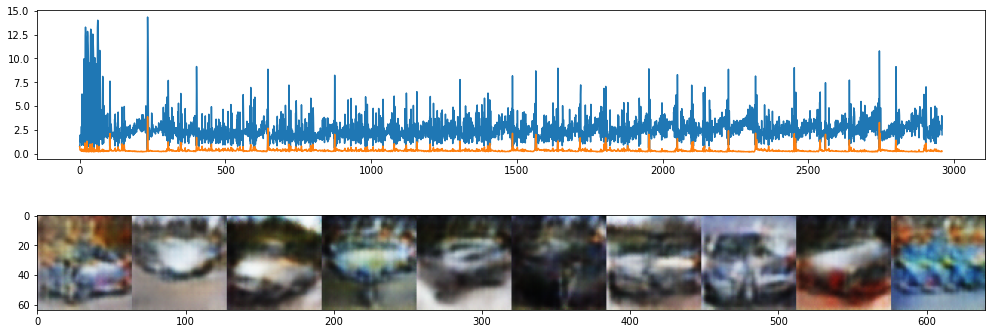

D_losses=0.2948 | G_losses=2.2892:  75%|███████▌  | 75/100 [16:41<05:36, 13.45s/it]

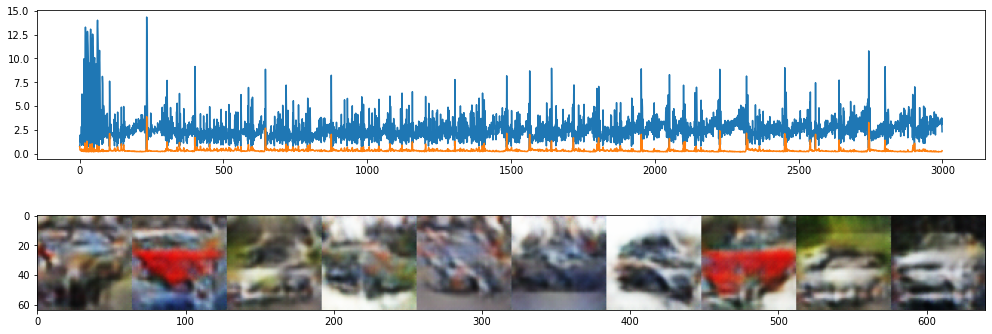

D_losses=0.2356 | G_losses=2.4600:  76%|███████▌  | 76/100 [16:55<05:22, 13.44s/it]

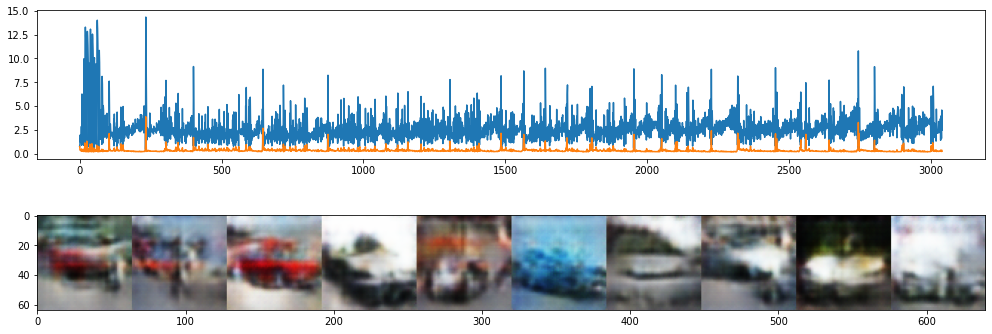

D_losses=0.2868 | G_losses=3.2788:  77%|███████▋  | 77/100 [17:08<05:08, 13.40s/it]

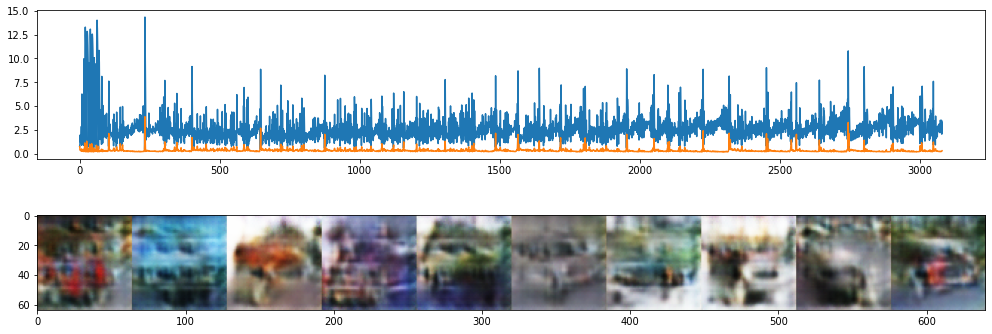

D_losses=0.3651 | G_losses=2.1761:  78%|███████▊  | 78/100 [17:22<04:55, 13.43s/it]

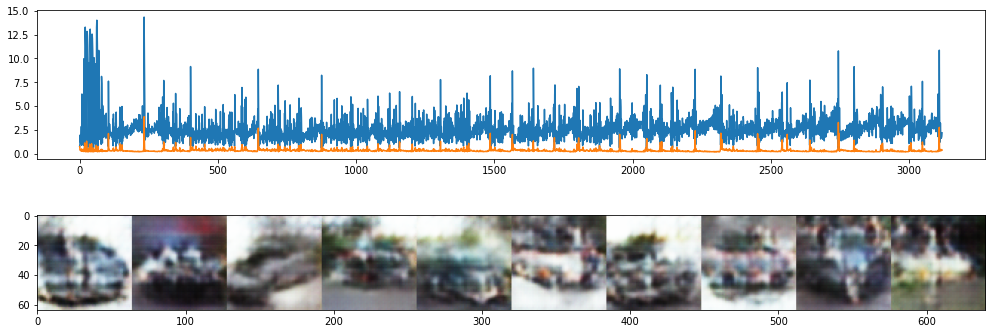

D_losses=0.2674 | G_losses=3.0442:  79%|███████▉  | 79/100 [17:35<04:41, 13.41s/it]

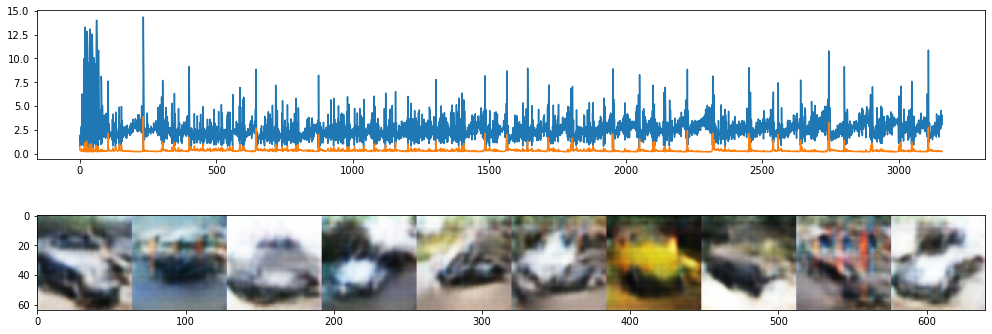

D_losses=0.4308 | G_losses=5.1045:  80%|████████  | 80/100 [17:48<04:28, 13.41s/it]

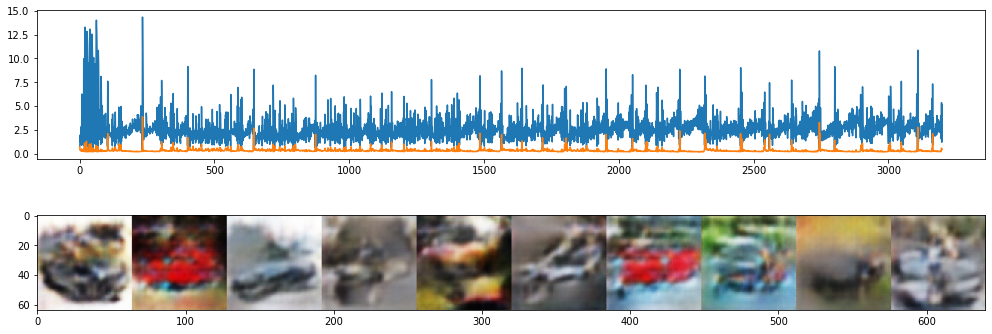

D_losses=0.1843 | G_losses=4.1777:  81%|████████  | 81/100 [18:02<04:13, 13.36s/it]

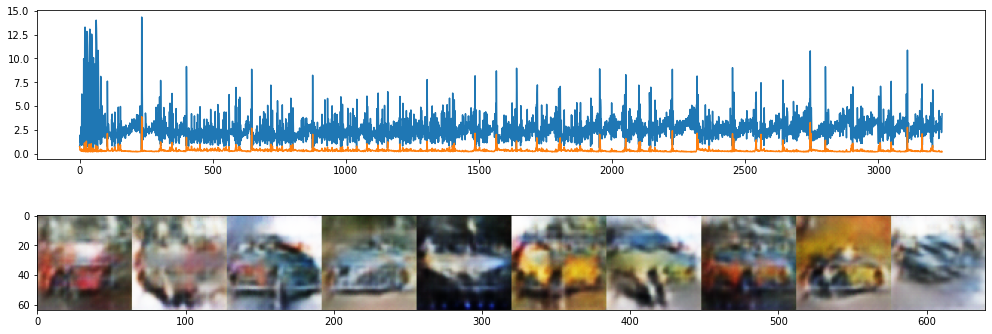

D_losses=0.4781 | G_losses=2.2966:  82%|████████▏ | 82/100 [18:15<04:00, 13.35s/it]

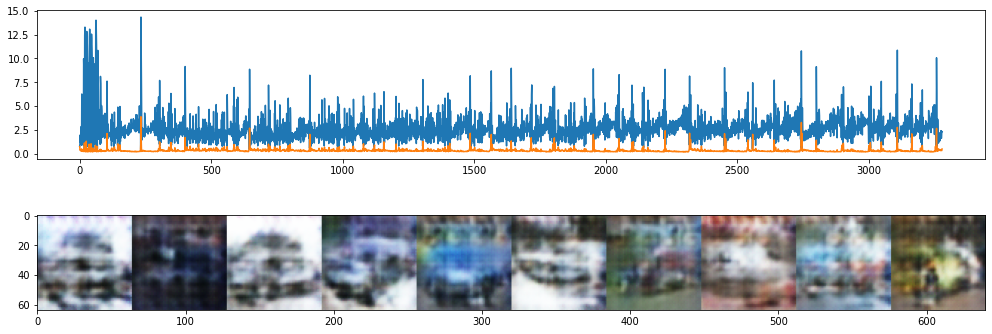

D_losses=0.3175 | G_losses=1.5682:  83%|████████▎ | 83/100 [18:28<03:46, 13.32s/it]

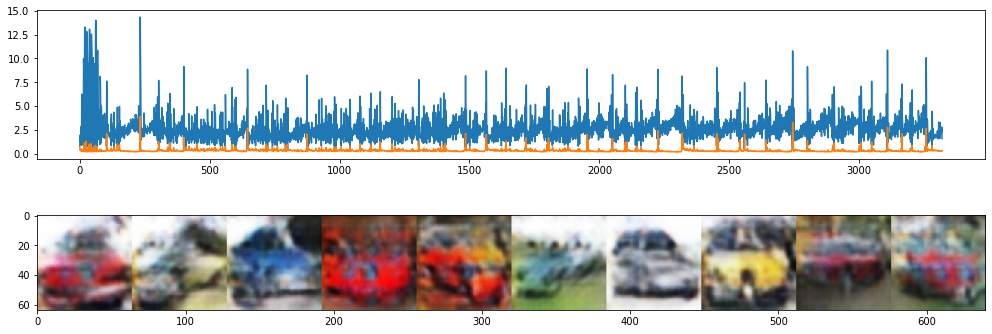

D_losses=0.2643 | G_losses=4.7175:  84%|████████▍ | 84/100 [18:42<03:33, 13.32s/it]

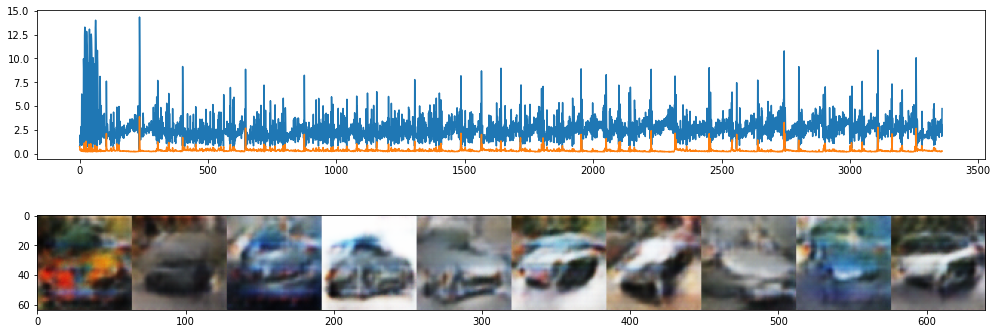

D_losses=0.2431 | G_losses=2.5286:  85%|████████▌ | 85/100 [18:55<03:20, 13.40s/it]

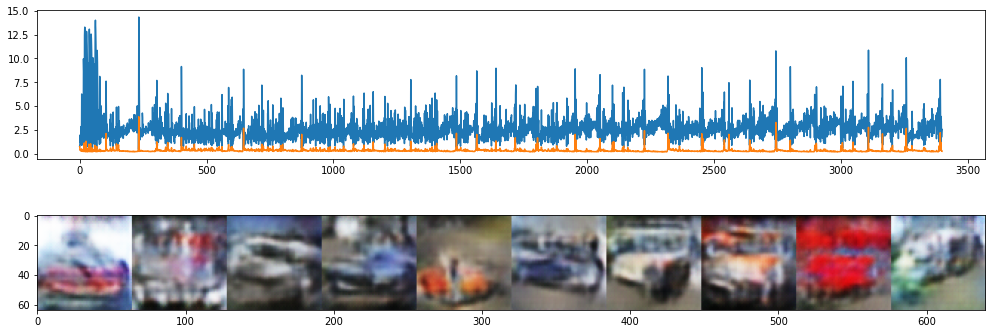

D_losses=0.2040 | G_losses=3.6022:  86%|████████▌ | 86/100 [19:09<03:07, 13.42s/it]

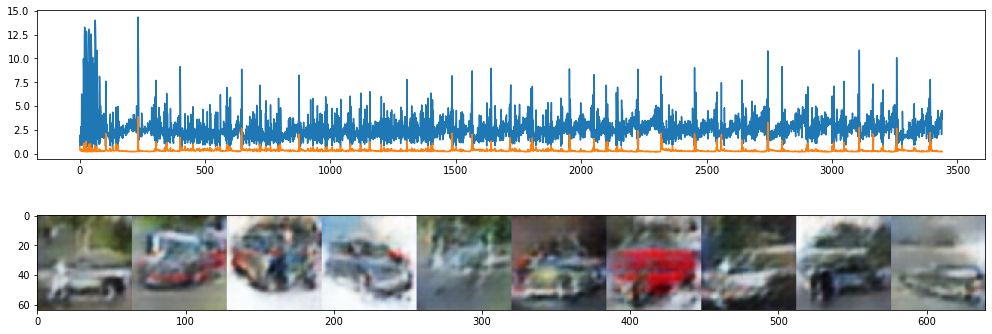

D_losses=0.1861 | G_losses=3.0656:  87%|████████▋ | 87/100 [19:22<02:54, 13.39s/it]

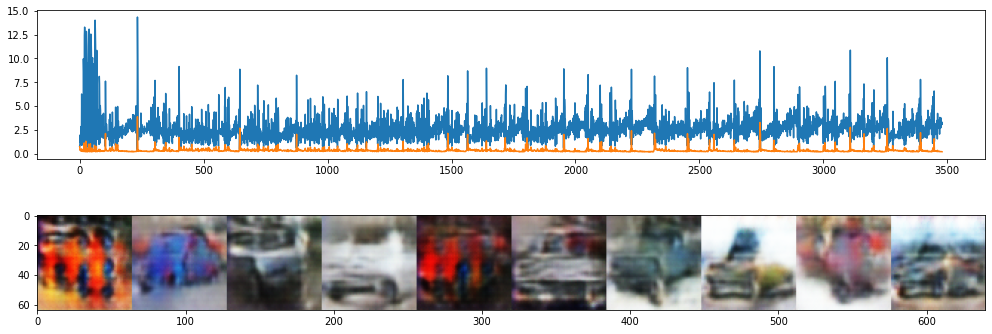

D_losses=0.1831 | G_losses=3.9756:  88%|████████▊ | 88/100 [19:35<02:40, 13.37s/it]

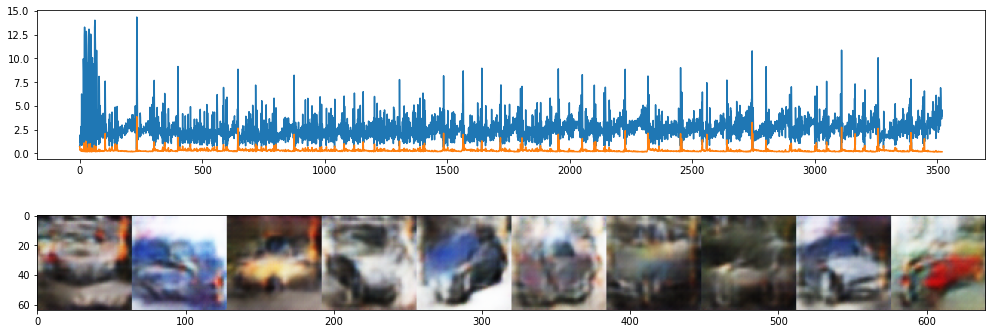

D_losses=0.2641 | G_losses=2.5944:  89%|████████▉ | 89/100 [19:49<02:27, 13.37s/it]

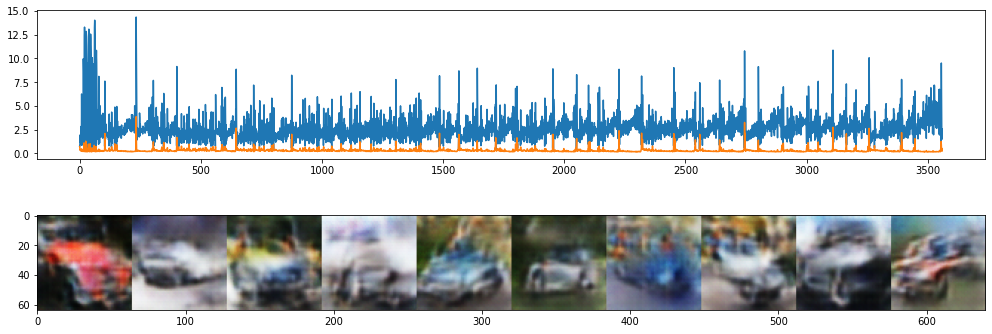

D_losses=0.3664 | G_losses=1.5387:  90%|█████████ | 90/100 [20:02<02:13, 13.39s/it]

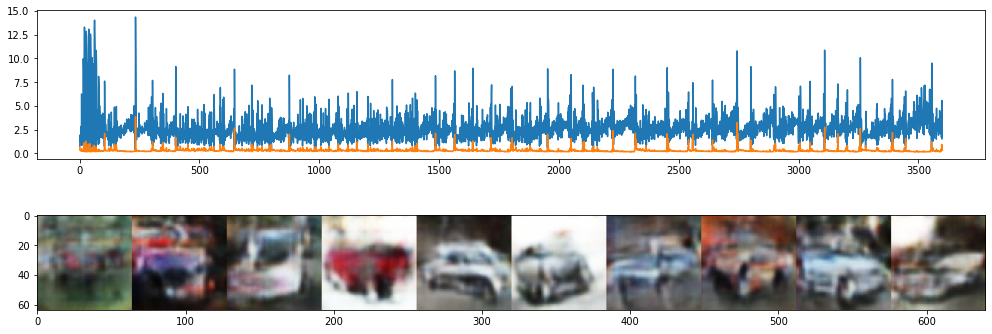

D_losses=0.1919 | G_losses=3.0481:  91%|█████████ | 91/100 [20:15<02:00, 13.37s/it]

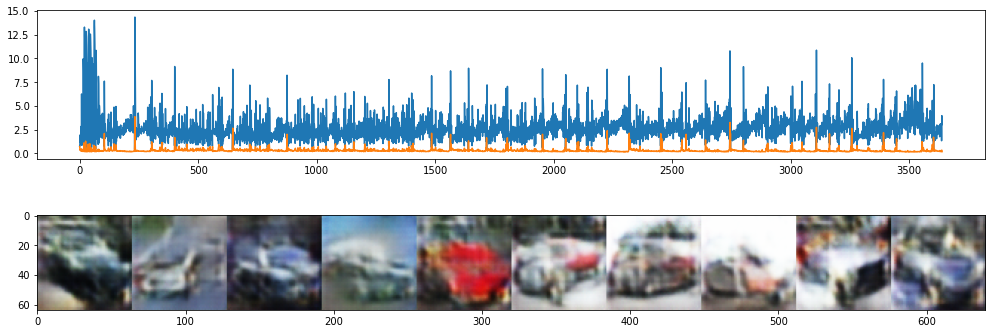

D_losses=0.2109 | G_losses=3.0964:  92%|█████████▏| 92/100 [20:29<01:47, 13.43s/it]

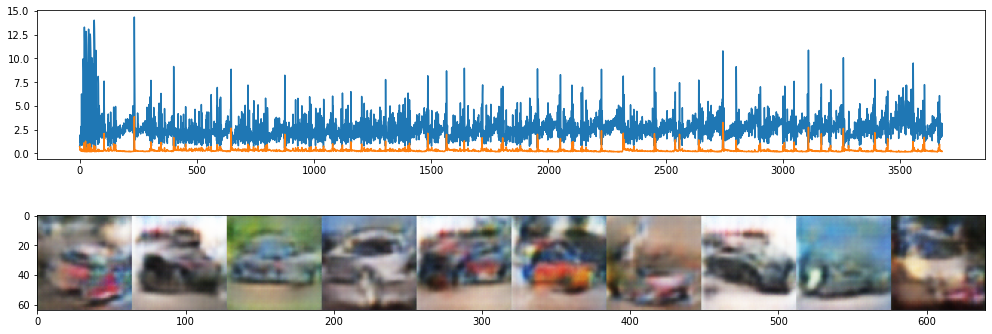

D_losses=0.1917 | G_losses=3.7407:  93%|█████████▎| 93/100 [20:42<01:33, 13.40s/it]

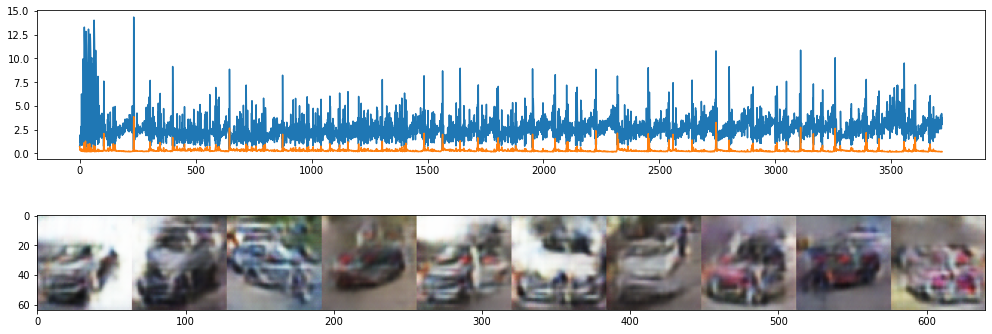

D_losses=0.2256 | G_losses=2.9759:  94%|█████████▍| 94/100 [20:56<01:20, 13.38s/it]

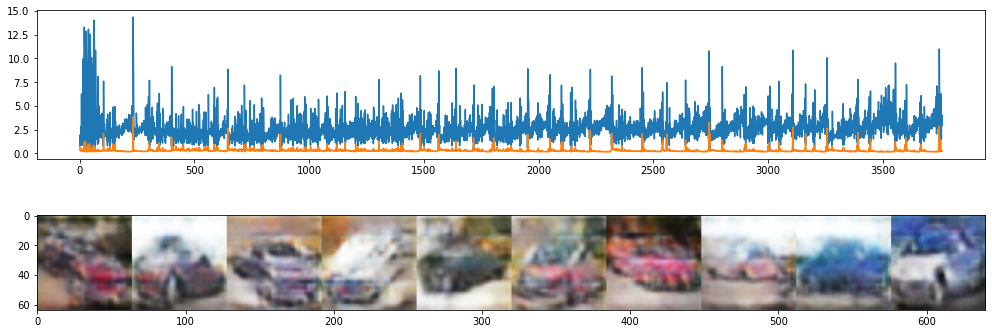

D_losses=0.1859 | G_losses=3.7991:  95%|█████████▌| 95/100 [21:09<01:06, 13.38s/it]

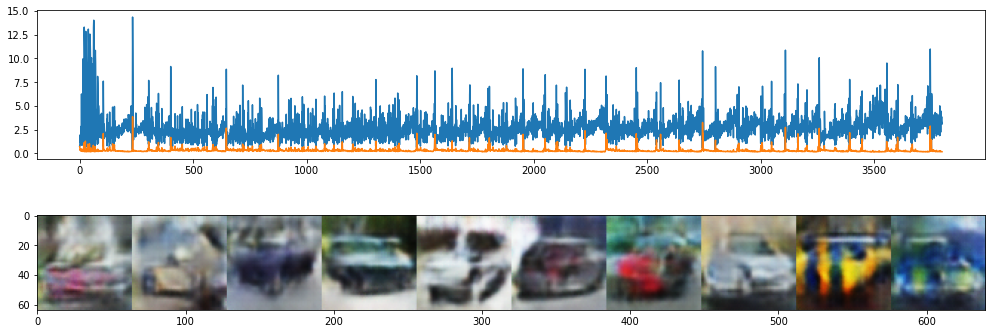

D_losses=0.2335 | G_losses=2.3966:  96%|█████████▌| 96/100 [21:22<00:53, 13.38s/it]

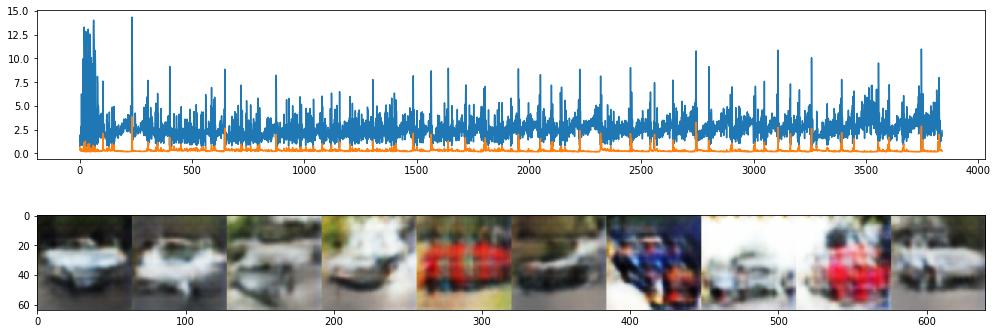

D_losses=0.4213 | G_losses=0.9972:  97%|█████████▋| 97/100 [21:36<00:40, 13.38s/it]

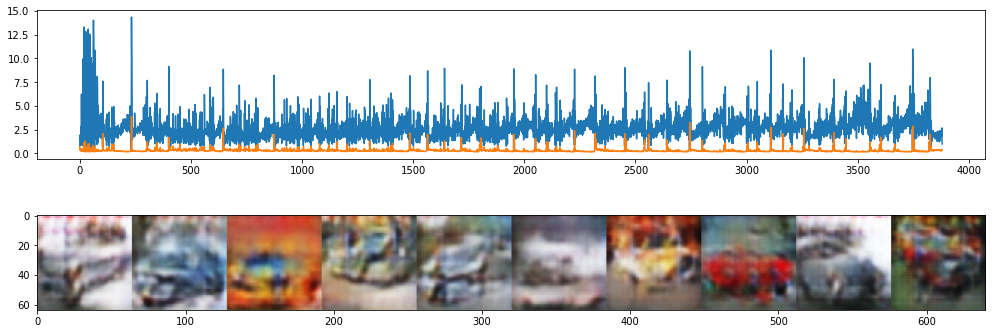

D_losses=0.2723 | G_losses=3.4643:  98%|█████████▊| 98/100 [21:49<00:26, 13.40s/it]

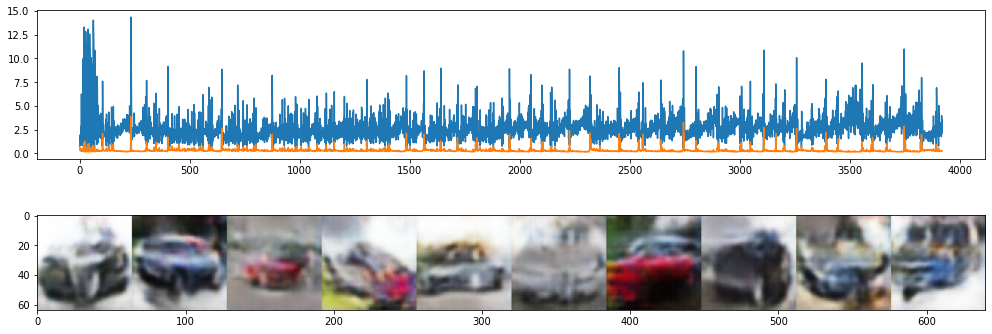

D_losses=0.1926 | G_losses=3.6181:  99%|█████████▉| 99/100 [22:03<00:13, 13.39s/it]

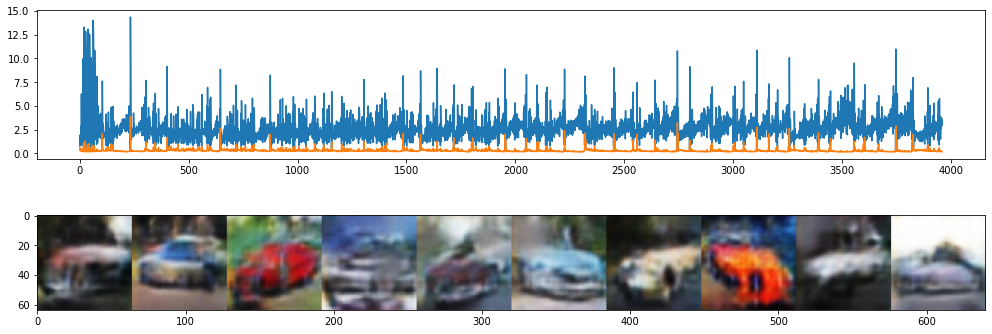

D_losses=0.1781 | G_losses=4.7881: 100%|██████████| 100/100 [22:16<00:00, 13.37s/it]


In [8]:
g_crit = nn.BCELoss()
d_crit = nn.BCELoss()
g_optim = torch.optim.Adam(g.parameters(), lr=2e-4, betas=(.5, .999))
d_optim = torch.optim.Adam(d.parameters(), lr=2e-4, betas=(.5, .999))

epochs = 100

for epoch in (t := trange(epochs)):
    implot(g(torch.randn((BS, 100), device=dev))[:10], losses=True, save=True)
    save()
    train_test_loop(dtld)
    t.set_description(f'D_losses=%.4f | G_losses=%.4f' % (d_losses[-1], g_losses[-1]))

In [ ]:
checkpoint = torch.load('checkpoint.pth') 
load = False
if load:
    g.load_state_dict(checkpoint['g_state_dict'])
    d.load_state_dict(checkpoint['d_state_dict'])
    g_optim.load_state_dict(checkpoint['g_optim_state_dict'])
    d_optim.load_state_dict(checkpoint['d_optim_state_dict'])
    g_losses = checkpoint['g_losses']
    d_losses = checkpoint['d_losses']

In [9]:
def save():
    torch.save({
                'epoch': epoch,
                 'g_state_dict': g.state_dict(),
                'd_state_dict': d.state_dict(),
                'g_optim_state_dict': g_optim.state_dict(),
                'd_optim_state_dict': d_optim.state_dict(),
                'g_losses': g_losses,
                'd_losses': d_losses,
                }, 'checkpoint.pth')
save()

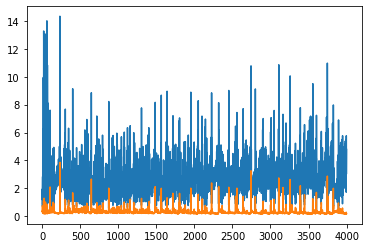

In [11]:
plt.plot(g_losses, label='Generator losses')
plt.plot(d_losses, label='Discriminator losses')
plt.show()

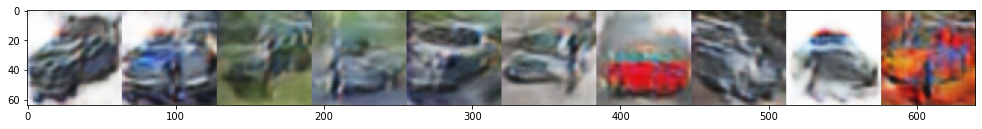

In [13]:
implot(g(torch.randn((128, 100), device=dev))[:10])